In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import pandas as pd

Reading the CSV file

In [5]:

file_path = "/content/drive/MyDrive/Colab Notebooks/Current File/pakistan_car_license_dataset.csv"
data = pd.read_csv(file_path)
print("Initial Dataset:")
data.head(100) # first few rows


Initial Dataset:


,License_Plate,Owner_Name,Car_Model,License_Valid,Registration_Region,Vehicle_Type,Vehicle_Color,Vehicle_Year,Inspection_Status,Unique_ID,Car_Stolen,Tokens_Paid
0,ATB-4453,Fatima Zain,Honda Civic,Invalid,Sialkot,SUV,White,2010,Failed,1,Yes,Yes
1,KHI-4893,Tariq Aziz,Honda City,Valid,Karachi,Truck,Green,2009,Failed,2,No,No
2,RWP-1670,Owais Shah,MG HS,Valid,Gilgit,Van,Blue,2010,Passed,3,No,No
3,SWL-3673,Nida Yasir,Honda City,Invalid,Sialkot,Coupe,Silver,2001,Passed,4,No,Yes
4,GIL-3258,Tariq Aziz,MG HS,Invalid,Islamabad,Van,Green,2006,Failed,5,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...
95,FSD-4943,Ali Khan,Suzuki Swift,Valid,Islamabad,Hatchback,Red,2010,Passed,98,Yes,Yes
96,51502J,Fatima Zain,Suzuki Mehran,Valid,Islamabad,Van,White,2020,Passed,99,Yes,No
97,BG65USJ,Ali Khan,Proton Saga,Valid,Rawalpindi,Hatchback,Green,1995,Failed,100,No,Yes
98,GX15OGJ,Ali Khan,Proton Saga,Valid,Rawalpindi,Hatchback,Green,1995,Failed,101,No,No


removing missing values

In [6]:
data = data.dropna(subset=["License_Plate", "Owner_Name", "Car_Model", "License_Valid"])

# Display remaining rows
print(f"\nDataset after removing rows with missing values: {data.shape[0]} rows")



Dataset after removing rows with missing values: 101 rows


Removing Duplicate Values

In [ ]:
# Remove duplicate rows based on License_Plate
data = data.drop_duplicates(subset=["License_Plate"], keep="first")

# Display the number of rows after removing duplicates
print(f"\nDataset after removing duplicates: {data.shape[0]} rows")



Dataset after removing duplicates: 101 rows


Standardizing Text Data

In [ ]:
# Step 4: Standardize Text Data
data["License_Plate"] = data["License_Plate"].str.strip().str.upper()
data["Owner_Name"] = data["Owner_Name"].str.strip().str.title()
data["Car_Model"] = data["Car_Model"].str.strip().str.title()
data["License_Valid"] = data["License_Valid"].str.strip().str.capitalize()

# Display a few rows after standardization
print("\nDataset after standardizing text data:")
data.head()



Dataset after standardizing text data:


,License_Plate,Owner_Name,Car_Model,License_Valid,Registration_Region,Vehicle_Type,Vehicle_Color,Vehicle_Year,Inspection_Status,Unique_ID,Car_Stolen,Tokens_Paid
0,ATB-4453,Fatima Zain,Honda Civic,Invalid,Sialkot,SUV,White,2010,Failed,1,Yes,Yes
1,KHI-4893,Tariq Aziz,Honda City,Valid,Karachi,Truck,Green,2009,Failed,2,No,No
2,RWP-1670,Owais Shah,Mg Hs,Valid,Gilgit,Van,Blue,2010,Passed,3,No,No
3,SWL-3673,Nida Yasir,Honda City,Invalid,Sialkot,Coupe,Silver,2001,Passed,4,No,Yes
4,GIL-3258,Tariq Aziz,Mg Hs,Invalid,Islamabad,Van,Green,2006,Failed,5,No,No


Encoding Categorical Variables

In [ ]:
# Encode 'Valid' as 1 and 'Invalid' as 0
data["License_Valid_Encoded"] = data["License_Valid"].map({"Valid": 1, "Invalid": 0})

# Display the first few rows with the new encoded column
print("\nDataset after encoding categorical variables:")
data[["License_Valid", "License_Valid_Encoded"]].head()



Dataset after encoding categorical variables:


,License_Valid,License_Valid_Encoded
0,Invalid,0
1,Valid,1
2,Valid,1
3,Invalid,0
4,Invalid,0


Final Cleaning (Removing unnecessary attributes)

In [ ]:

# Select columns relevant for the analysis
data = data[["License_Plate", "Owner_Name", "Car_Model", "Registration_Region","License_Valid", "License_Valid_Encoded"]]

# Display the cleaned dataset
print("\nFinal Cleaned Dataset:")
data.head()



Final Cleaned Dataset:


,License_Plate,Owner_Name,Car_Model,Registration_Region,License_Valid,License_Valid_Encoded
0,ATB-4453,Fatima Zain,Honda Civic,Sialkot,Invalid,0
1,KHI-4893,Tariq Aziz,Honda City,Karachi,Valid,1
2,RWP-1670,Owais Shah,Mg Hs,Gilgit,Valid,1
3,SWL-3673,Nida Yasir,Honda City,Sialkot,Invalid,0
4,GIL-3258,Tariq Aziz,Mg Hs,Islamabad,Invalid,0


Saving Final Dataset to CSV file

In [ ]:
output_file = "preprocessed_pakistan_car_license_dataset.csv"
data.to_csv(output_file, index=False)

print(f"\nProcessed dataset saved to: {output_file}")



Processed dataset saved to: preprocessed_pakistan_car_license_dataset.csv


Taking Sample of 30 values from the original dataset

In [ ]:
sample_df = data.sample(frac = 0.3, random_state=42)
sample_df

,License_Plate,Owner_Name,Car_Model,Registration_Region,License_Valid,License_Valid_Encoded
84,PES-9140,Usman Tariq,Toyota Corolla,Islamabad,Valid,1
55,SWL-9681,Zara Naeem,Changan Alsvin,Quetta,Invalid,0
66,ATB-2320,Ayesha Noor,Toyota Corolla,Sialkot,Invalid,0
67,LE-8212,Rabia Iqbal,Honda Civic,Rawalpindi,Valid,1
45,GIL-3916,Ayesha Noor,Suzuki Alto,Peshawar,Invalid,0
39,PES-2887,Kashif Mehmood,Proton Saga,Karachi,Valid,1
22,LE-4528,Zainab Khalid,Kia Sportage,Peshawar,Valid,1
44,FSD-3279,Ahmed Raza,Kia Sportage,Gilgit,Valid,1
10,RWP-1398,Usman Tariq,Suzuki Swift,Faisalabad,Invalid,0
0,ATB-4453,Fatima Zain,Honda Civic,Sialkot,Invalid,0


Visual Comparisons Using matplotlib & Seaborn  

In [ ]:
!pip install matplotlib

<Figure size 1200x800 with 0 Axes>

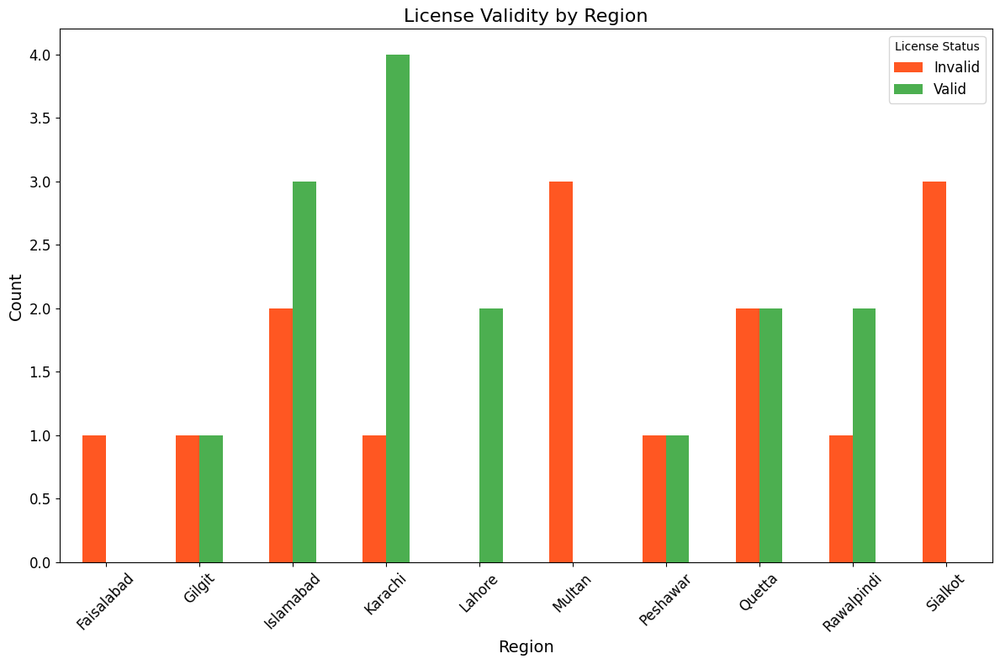

In [ ]:
import matplotlib.pyplot as plt
# License Validity by Region
plt.figure(figsize=(12, 8))

# Group data by region and license validity
region_validity = sample_df.groupby(["Registration_Region", "License_Valid"]).size().unstack()

# Plot the grouped bar chart
region_validity.plot(
    kind="bar",
    stacked=False,
    color={"Valid": "#4CAF50", "Invalid": "#FF5722"},  # Green for Valid, Red for Invalid
    figsize=(12, 8)
)

# Adding labels and title
plt.title("License Validity by Region", fontsize=16)
plt.xlabel("Region", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title="License Status", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn style for better visuals
sns.set_theme(style="whitegrid")

In [ ]:
# Set Seaborn style for better visuals
sns.set_theme(style="whitegrid")

1 Valid VS Invalid Licenses (Bar Chart)


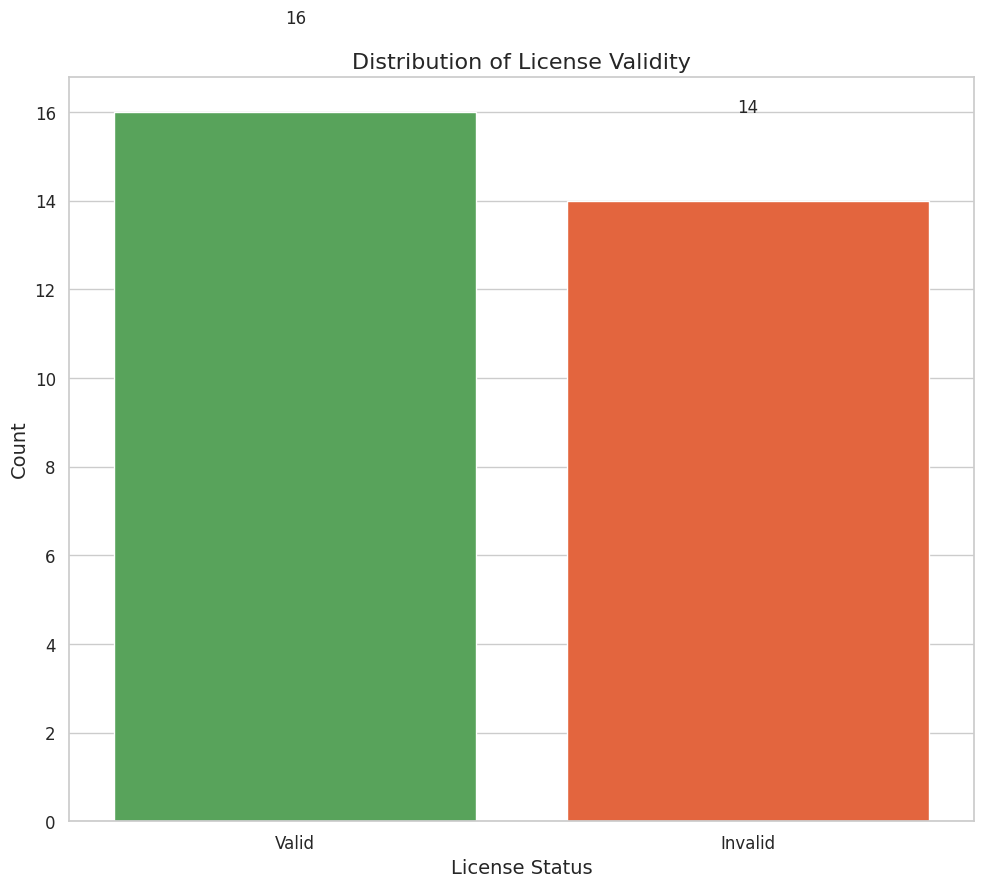

In [ ]:
plt.figure(figsize=(10,9))
license_counts = sample_df["License_Valid"].value_counts() #counting the validity attribute
sns.barplot(
    x=license_counts.index,
    y=license_counts.values,
    hue=license_counts.index,
    dodge=False,  # Ensures a single bar per category
    palette={"Valid": "#4CAF50", "Invalid": "#FF5722"}  # Green for Valid, Red for Invalid
)
plt.legend([], [], frameon=False)  # Removes legend

# Adding labels and title
plt.title("Distribution of License Validity", fontsize=16)
plt.xlabel("License Status", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Annotate values on bars
for i, value in enumerate(license_counts.values):
    plt.text(i, value + 2, str(value), ha="center", fontsize=12)

plt.tight_layout()
plt.show()




License Validity by Region (Bar Chart)

pip install ultralytics easyocr opencv-python


YOLOv8 Plate Detection

In [ ]:
!pip install ultralytics easyocr opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.7/898.7 kB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 56.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 19.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 20.7 MB/s eta 0:00:00



0: 384x640 21 cars, 1 bus, 2 trucks, 160.1ms
Speed: 4.3ms preprocess, 160.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 1 license_plate, 208.4ms
Speed: 4.4ms preprocess, 208.4ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 2 license_plates, 191.3ms
Speed: 4.1ms preprocess, 191.3ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 183.3ms
Speed: 5.0ms preprocess, 183.3ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)

0: 640x640 (no detections), 212.0ms
Speed: 4.6ms preprocess, 212.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 license_plate, 219.3ms
Speed: 4.4ms preprocess, 219.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 (no detections), 185.2ms
Speed: 5.0ms preprocess, 185.2ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)

0: 512x640 (no detections), 186.6ms
Speed: 3

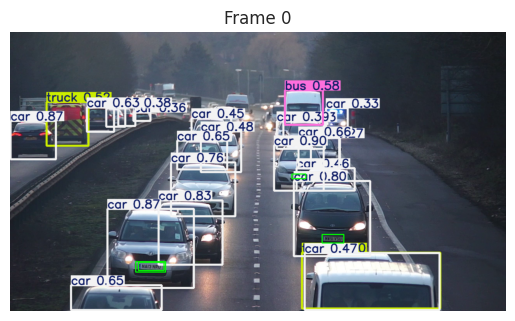


0: 384x640 22 cars, 1 bus, 2 trucks, 202.6ms
Speed: 2.7ms preprocess, 202.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 1 license_plate, 312.7ms
Speed: 4.4ms preprocess, 312.7ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 311.1ms
Speed: 4.0ms preprocess, 311.1ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 336.9ms
Speed: 8.9ms preprocess, 336.9ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 (no detections), 344.5ms
Speed: 4.8ms preprocess, 344.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 license_plate, 380.4ms
Speed: 9.9ms preprocess, 380.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 (no detections), 301.2ms
Speed: 7.5ms preprocess, 301.2ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 384x640 (no detections), 212.6ms
Speed: 5.

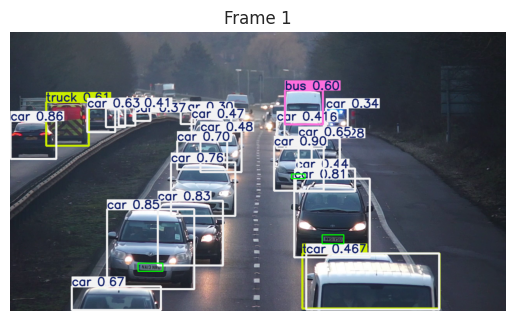


0: 384x640 20 cars, 1 bus, 2 trucks, 179.6ms
Speed: 3.2ms preprocess, 179.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 1 license_plate, 234.0ms
Speed: 4.3ms preprocess, 234.0ms inference, 1.1ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 (no detections), 195.5ms
Speed: 4.2ms preprocess, 195.5ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)

0: 640x640 (no detections), 241.9ms
Speed: 6.1ms preprocess, 241.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 608x640 1 license_plate, 244.6ms
Speed: 5.0ms preprocess, 244.6ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 1 license_plate, 226.2ms
Speed: 4.8ms preprocess, 226.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 1 license_plate, 220.2ms
Speed: 4.7ms preprocess, 220.2ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 640)

0: 384x640 (no detections), 162.4ms
Speed: 3.

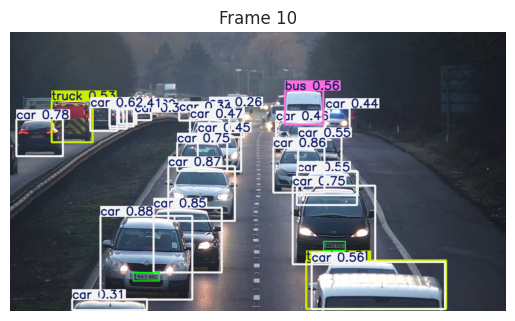


0: 384x640 23 cars, 1 bus, 1 truck, 181.5ms
Speed: 2.7ms preprocess, 181.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 (no detections), 217.9ms
Speed: 5.6ms preprocess, 217.9ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 229.5ms
Speed: 4.1ms preprocess, 229.5ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 219.2ms
Speed: 4.9ms preprocess, 219.2ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 228.2ms
Speed: 4.5ms preprocess, 228.2ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 (no detections), 225.1ms
Speed: 3.7ms preprocess, 225.1ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 384x640 (no detections), 156.9ms
Speed: 2.9ms preprocess, 156.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 640x640 1 license_plate, 236.1ms
Speed: 4.4

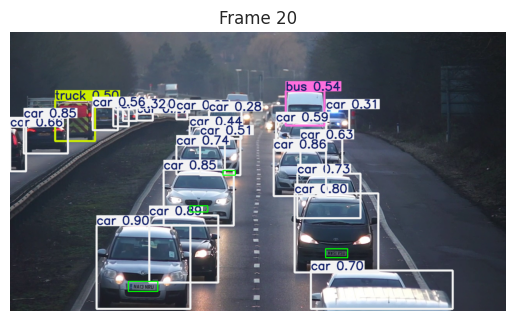


0: 384x640 21 cars, 1 bus, 2 trucks, 190.0ms
Speed: 7.7ms preprocess, 190.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 (no detections), 207.3ms
Speed: 4.1ms preprocess, 207.3ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 253.8ms
Speed: 6.2ms preprocess, 253.8ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 (no detections), 248.7ms
Speed: 4.7ms preprocess, 248.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 608x640 (no detections), 229.5ms
Speed: 4.5ms preprocess, 229.5ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 1 license_plate, 248.8ms
Speed: 8.3ms preprocess, 248.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 512x640 1 license_plate, 229.6ms
Speed: 8.1ms preprocess, 229.6ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 192x640 (no detections), 99.9ms
Speed: 2.0

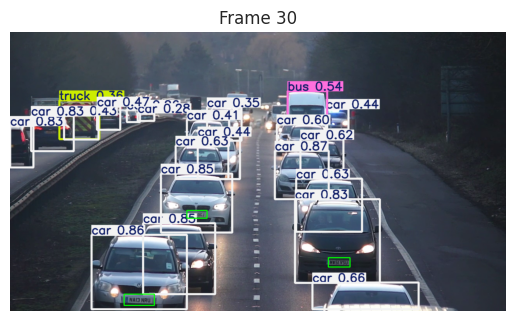


0: 384x640 20 cars, 1 bus, 1 truck, 304.1ms
Speed: 8.0ms preprocess, 304.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 344.6ms
Speed: 5.7ms preprocess, 344.6ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 1 license_plate, 306.9ms
Speed: 4.0ms preprocess, 306.9ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 1 license_plate, 355.6ms
Speed: 5.6ms preprocess, 355.6ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 640x640 (no detections), 403.8ms
Speed: 8.8ms preprocess, 403.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 (no detections), 363.1ms
Speed: 5.1ms preprocess, 363.1ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 640x640 1 license_plate, 384.8ms
Speed: 5.4ms preprocess, 384.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x384 (no detections), 245.0ms
Speed: 2.9

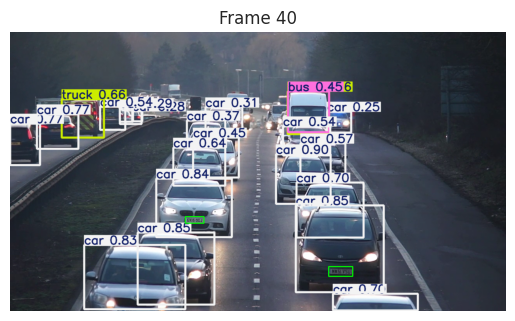


0: 384x640 19 cars, 1 bus, 1 truck, 216.6ms
Speed: 5.8ms preprocess, 216.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 237.4ms
Speed: 4.5ms preprocess, 237.4ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 1 license_plate, 220.6ms
Speed: 4.0ms preprocess, 220.6ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)

0: 608x640 (no detections), 242.7ms
Speed: 4.4ms preprocess, 242.7ms inference, 0.7ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 1 license_plate, 266.6ms
Speed: 7.0ms preprocess, 266.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

0: 416x640 (no detections), 187.1ms
Speed: 3.5ms preprocess, 187.1ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 640)

0: 640x480 (no detections), 225.2ms
Speed: 3.6ms preprocess, 225.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)

0: 544x640 (no detections), 233.0ms
Speed: 5.3

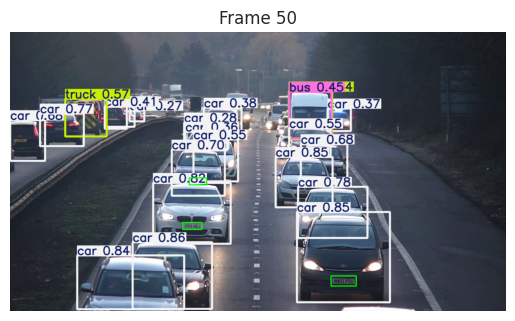


0: 384x640 19 cars, 1 bus, 3 trucks, 206.7ms
Speed: 5.2ms preprocess, 206.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 640x640 1 license_plate, 296.3ms
Speed: 5.4ms preprocess, 296.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 (no detections), 230.1ms
Speed: 4.2ms preprocess, 230.1ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 243.1ms
Speed: 4.2ms preprocess, 243.1ms inference, 0.6ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 1 license_plate, 230.9ms
Speed: 6.9ms preprocess, 230.9ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)

0: 320x640 (no detections), 170.9ms
Speed: 2.8ms preprocess, 170.9ms inference, 0.9ms postprocess per image at shape (1, 3, 320, 640)

0: 512x640 (no detections), 232.9ms
Speed: 3.5ms preprocess, 232.9ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)

0: 480x640 (no detections), 203.5ms
Speed: 4.

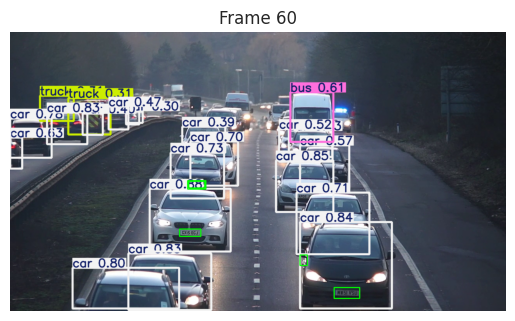


0: 384x640 20 cars, 1 bus, 1 truck, 206.8ms
Speed: 3.0ms preprocess, 206.8ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 247.9ms
Speed: 3.9ms preprocess, 247.9ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 (no detections), 254.6ms
Speed: 4.5ms preprocess, 254.6ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 289.9ms
Speed: 5.3ms preprocess, 289.9ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 (no detections), 227.0ms
Speed: 4.0ms preprocess, 227.0ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 448x640 (no detections), 228.1ms
Speed: 3.8ms preprocess, 228.1ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)

0: 256x640 (no detections), 161.5ms
Speed: 3.2ms preprocess, 161.5ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 640)

0: 608x640 (no detections), 293.6ms
Speed: 5.5

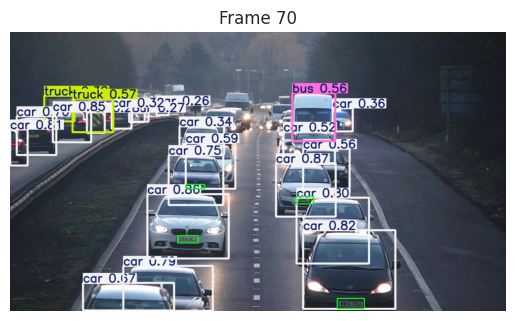


0: 384x640 21 cars, 1 bus, 2 trucks, 210.5ms
Speed: 7.3ms preprocess, 210.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 268.2ms
Speed: 4.6ms preprocess, 268.2ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 251.3ms
Speed: 4.5ms preprocess, 251.3ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 246.5ms
Speed: 4.6ms preprocess, 246.5ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)

0: 544x640 (no detections), 252.2ms
Speed: 4.4ms preprocess, 252.2ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)

0: 640x320 (no detections), 239.4ms
Speed: 3.8ms preprocess, 239.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 320)

0: 320x640 (no detections), 183.2ms
Speed: 4.1ms preprocess, 183.2ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)

0: 544x640 1 license_plate, 246.9ms
Speed: 4.

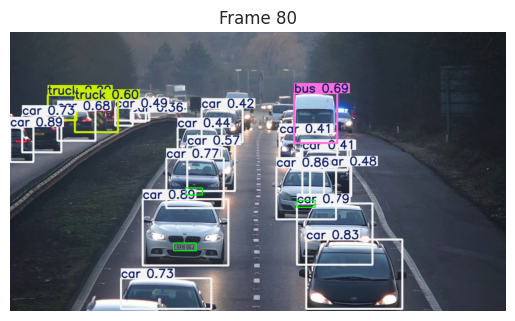


0: 384x640 23 cars, 1 bus, 1 truck, 273.3ms
Speed: 3.5ms preprocess, 273.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 325.5ms
Speed: 4.2ms preprocess, 325.5ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 640x448 (no detections), 287.2ms
Speed: 3.4ms preprocess, 287.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 448)

0: 576x640 1 license_plate, 369.8ms
Speed: 5.8ms preprocess, 369.8ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 448x640 (no detections), 340.3ms
Speed: 7.3ms preprocess, 340.3ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)

0: 544x640 (no detections), 334.1ms
Speed: 4.4ms preprocess, 334.1ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)

0: 544x640 (no detections), 321.3ms
Speed: 6.1ms preprocess, 321.3ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 1 license_plate, 325.4ms
Speed: 7.9

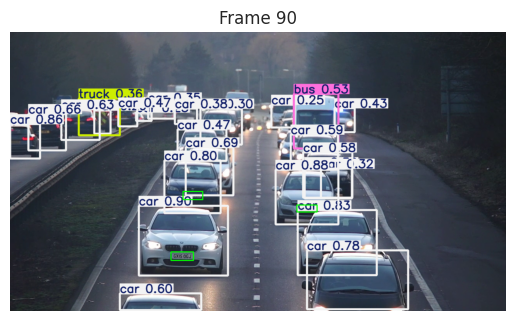


0: 384x640 21 cars, 1 bus, 1 truck, 229.4ms
Speed: 3.3ms preprocess, 229.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 251.5ms
Speed: 4.6ms preprocess, 251.5ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 263.9ms
Speed: 6.6ms preprocess, 263.9ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)

0: 640x576 (no detections), 270.9ms
Speed: 4.2ms preprocess, 270.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 576)

0: 544x640 (no detections), 246.9ms
Speed: 4.6ms preprocess, 246.9ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 640)

0: 384x640 (no detections), 226.5ms
Speed: 3.4ms preprocess, 226.5ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 1 license_plate, 282.1ms
Speed: 9.3ms preprocess, 282.1ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 253.5ms
Speed: 5.4

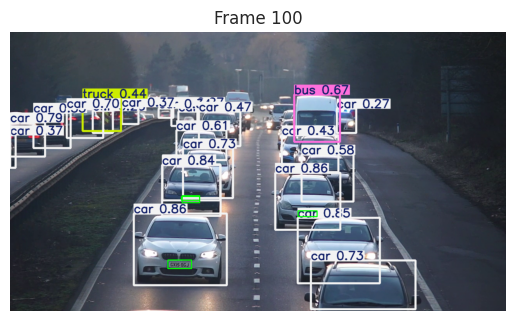


0: 384x640 22 cars, 1 bus, 1 truck, 252.1ms
Speed: 3.3ms preprocess, 252.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 (no detections), 315.4ms
Speed: 3.4ms preprocess, 315.4ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 330.3ms
Speed: 4.0ms preprocess, 330.3ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 1 license_plate, 353.2ms
Speed: 4.7ms preprocess, 353.2ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 378.3ms
Speed: 4.0ms preprocess, 378.3ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 (no detections), 343.4ms
Speed: 6.3ms preprocess, 343.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 256x640 (no detections), 149.9ms
Speed: 2.8ms preprocess, 149.9ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 640)

0: 640x640 (no detections), 346.2ms
Speed: 9.1

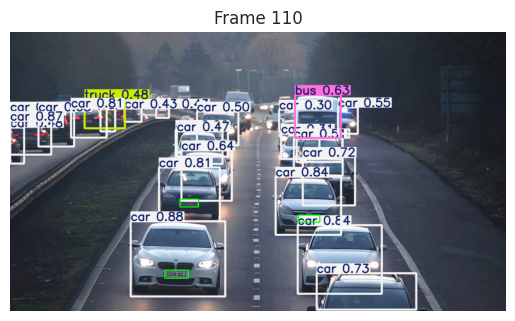


0: 384x640 24 cars, 1 bus, 1 truck, 247.2ms
Speed: 3.2ms preprocess, 247.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 252.9ms
Speed: 4.4ms preprocess, 252.9ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 (no detections), 264.3ms
Speed: 4.0ms preprocess, 264.3ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)

0: 512x640 (no detections), 257.4ms
Speed: 3.9ms preprocess, 257.4ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 303.7ms
Speed: 5.3ms preprocess, 303.7ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 299.9ms
Speed: 4.8ms preprocess, 299.9ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 259.1ms
Speed: 4.1ms preprocess, 259.1ms inference, 0.7ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 (no detections), 299.7ms
Speed: 5.6

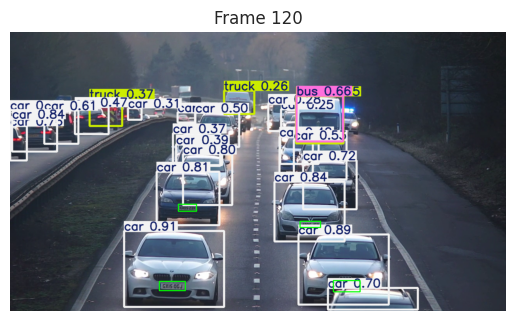


0: 384x640 23 cars, 1 bus, 2 trucks, 312.0ms
Speed: 3.6ms preprocess, 312.0ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 363.6ms
Speed: 6.4ms preprocess, 363.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 1 license_plate, 331.8ms
Speed: 4.3ms preprocess, 331.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 480x640 (no detections), 284.0ms
Speed: 7.2ms preprocess, 284.0ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 576x640 1 license_plate, 318.8ms
Speed: 6.1ms preprocess, 318.8ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 304.5ms
Speed: 4.5ms preprocess, 304.5ms inference, 2.3ms postprocess per image at shape (1, 3, 576, 640)

0: 640x320 (no detections), 197.1ms
Speed: 4.3ms preprocess, 197.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 320)

0: 640x640 (no detections), 323.0ms
Speed: 7.

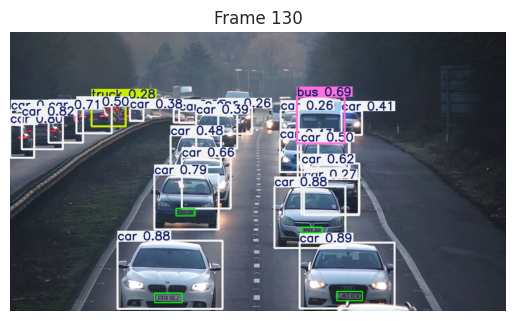


0: 384x640 22 cars, 1 bus, 2 trucks, 219.1ms
Speed: 6.1ms preprocess, 219.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 448x640 1 license_plate, 233.3ms
Speed: 3.6ms preprocess, 233.3ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)

0: 576x640 1 license_plate, 305.7ms
Speed: 6.6ms preprocess, 305.7ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 416x640 1 license_plate, 238.3ms
Speed: 3.6ms preprocess, 238.3ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)

0: 512x640 (no detections), 320.1ms
Speed: 6.9ms preprocess, 320.1ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 640x448 (no detections), 302.6ms
Speed: 3.8ms preprocess, 302.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 448)

0: 544x640 1 license_plate, 377.1ms
Speed: 4.2ms preprocess, 377.1ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 640x640 (no detections), 353.6ms
Speed: 7.

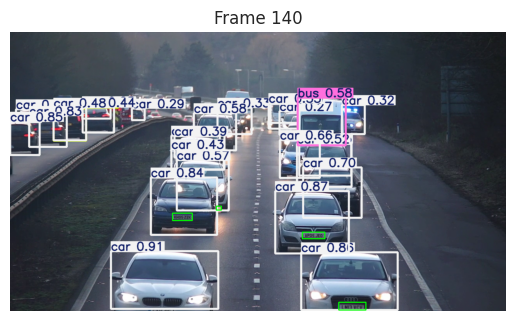


0: 384x640 24 cars, 1 bus, 2 trucks, 237.5ms
Speed: 3.0ms preprocess, 237.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 352x640 (no detections), 219.9ms
Speed: 2.7ms preprocess, 219.9ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)

0: 384x640 (no detections), 205.9ms
Speed: 2.9ms preprocess, 205.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 311.6ms
Speed: 4.7ms preprocess, 311.6ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 640x608 (no detections), 340.2ms
Speed: 6.0ms preprocess, 340.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 608)

0: 576x640 1 license_plate, 355.0ms
Speed: 4.5ms preprocess, 355.0ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 299.7ms
Speed: 7.1ms preprocess, 299.7ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 355.2ms
Speed: 6.

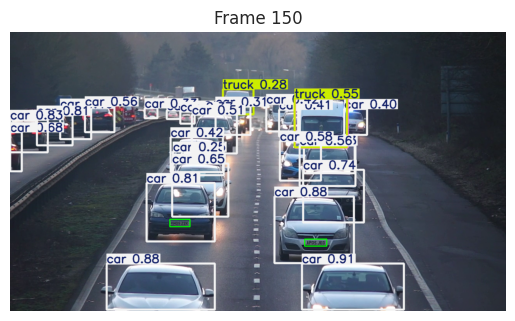


0: 384x640 24 cars, 1 bus, 2 trucks, 261.3ms
Speed: 3.3ms preprocess, 261.3ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)

0: 288x640 (no detections), 168.7ms
Speed: 3.3ms preprocess, 168.7ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)

0: 544x640 1 license_plate, 329.0ms
Speed: 4.4ms preprocess, 329.0ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 288x640 (no detections), 180.6ms
Speed: 4.4ms preprocess, 180.6ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)

0: 576x640 (no detections), 333.9ms
Speed: 4.6ms preprocess, 333.9ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 311.6ms
Speed: 4.5ms preprocess, 311.6ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 309.8ms
Speed: 4.8ms preprocess, 309.8ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 312.7ms
Speed: 5.

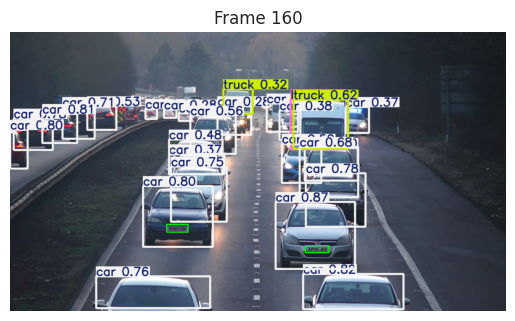


0: 384x640 24 cars, 1 bus, 2 trucks, 302.6ms
Speed: 3.3ms preprocess, 302.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 328.3ms
Speed: 4.5ms preprocess, 328.3ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 369.1ms
Speed: 4.2ms preprocess, 369.1ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 640x320 (no detections), 229.3ms
Speed: 3.7ms preprocess, 229.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 320)

0: 512x640 (no detections), 325.1ms
Speed: 4.6ms preprocess, 325.1ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 224x640 (no detections), 144.3ms
Speed: 2.1ms preprocess, 144.3ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 640)

0: 576x640 1 license_plate, 363.9ms
Speed: 5.1ms preprocess, 363.9ms inference, 5.5ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 411.5ms
Speed: 4.

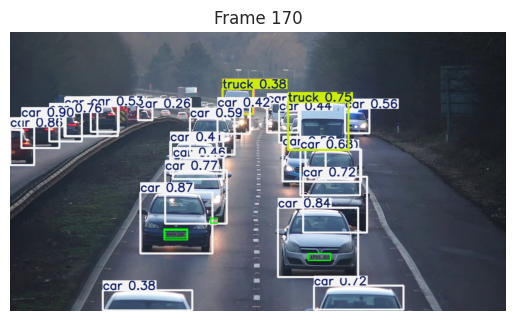


0: 384x640 26 cars, 1 bus, 2 trucks, 226.5ms
Speed: 6.1ms preprocess, 226.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 640x448 (no detections), 243.9ms
Speed: 4.5ms preprocess, 243.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 448)

0: 512x640 (no detections), 270.8ms
Speed: 5.0ms preprocess, 270.8ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 1 license_plate, 301.5ms
Speed: 4.0ms preprocess, 301.5ms inference, 2.0ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 311.8ms
Speed: 4.4ms preprocess, 311.8ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 344.7ms
Speed: 6.3ms preprocess, 344.7ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 319.2ms
Speed: 7.9ms preprocess, 319.2ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)

0: 160x640 (no detections), 105.7ms
Speed: 1.

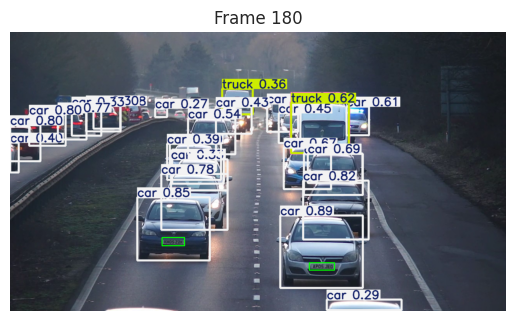


0: 384x640 25 cars, 1 bus, 2 trucks, 270.4ms
Speed: 3.4ms preprocess, 270.4ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 416.8ms
Speed: 4.5ms preprocess, 416.8ms inference, 4.5ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 408.3ms
Speed: 8.0ms preprocess, 408.3ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 378.1ms
Speed: 4.6ms preprocess, 378.1ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 (no detections), 367.1ms
Speed: 5.6ms preprocess, 367.1ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 640)

0: 640x576 (no detections), 313.5ms
Speed: 4.8ms preprocess, 313.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 576)

0: 544x640 (no detections), 311.8ms
Speed: 10.8ms preprocess, 311.8ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 640x640 (no detections), 389.5ms
Speed: 5

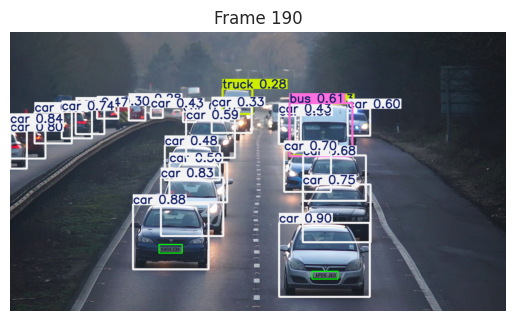


0: 384x640 21 cars, 1 bus, 2 trucks, 289.5ms
Speed: 4.3ms preprocess, 289.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 322.1ms
Speed: 5.0ms preprocess, 322.1ms inference, 1.2ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 1 license_plate, 319.4ms
Speed: 8.2ms preprocess, 319.4ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 368.8ms
Speed: 6.6ms preprocess, 368.8ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 640)

0: 640x320 (no detections), 286.3ms
Speed: 2.9ms preprocess, 286.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 320)

0: 640x640 (no detections), 405.8ms
Speed: 6.9ms preprocess, 405.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)

0: 576x640 (no detections), 393.5ms
Speed: 4.4ms preprocess, 393.5ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 430.0ms
Speed: 5.

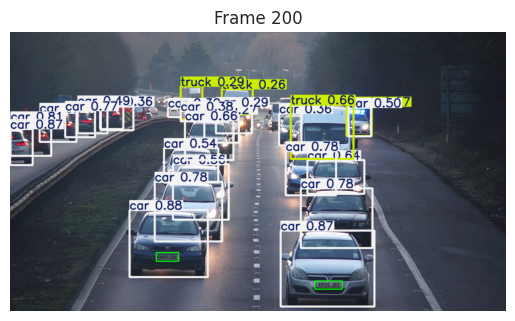


0: 384x640 23 cars, 3 trucks, 226.5ms
Speed: 5.6ms preprocess, 226.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 313.7ms
Speed: 4.5ms preprocess, 313.7ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 290.5ms
Speed: 4.1ms preprocess, 290.5ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 640x416 (no detections), 231.5ms
Speed: 3.0ms preprocess, 231.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 416)

0: 576x640 (no detections), 317.5ms
Speed: 5.4ms preprocess, 317.5ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 315.5ms
Speed: 4.0ms preprocess, 315.5ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 296.2ms
Speed: 4.0ms preprocess, 296.2ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 286.1ms
Speed: 4.2ms pre

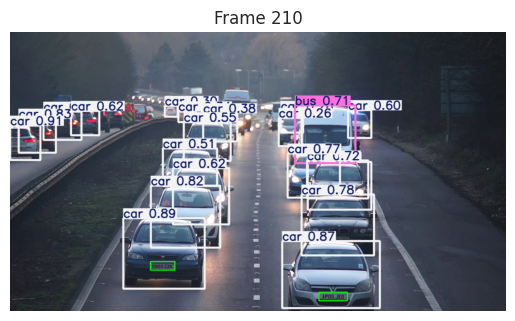


0: 384x640 21 cars, 1 bus, 286.8ms
Speed: 6.6ms preprocess, 286.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 640x576 (no detections), 378.7ms
Speed: 5.7ms preprocess, 378.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 576)

0: 576x640 1 license_plate, 326.0ms
Speed: 4.5ms preprocess, 326.0ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 448x640 1 license_plate, 286.5ms
Speed: 3.5ms preprocess, 286.5ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)

0: 608x640 (no detections), 341.2ms
Speed: 4.8ms preprocess, 341.2ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 336.7ms
Speed: 4.6ms preprocess, 336.7ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 323.2ms
Speed: 4.3ms preprocess, 323.2ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 320.6ms
Speed: 7.7ms prepro

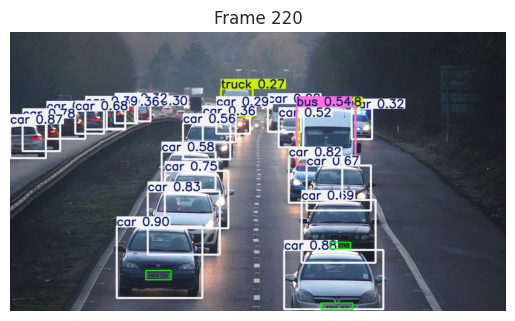


0: 384x640 22 cars, 1 bus, 2 trucks, 305.1ms
Speed: 4.6ms preprocess, 305.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 319.1ms
Speed: 4.7ms preprocess, 319.1ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)

0: 384x640 (no detections), 287.9ms
Speed: 3.3ms preprocess, 287.9ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 (no detections), 379.8ms
Speed: 4.6ms preprocess, 379.8ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 357.6ms
Speed: 4.6ms preprocess, 357.6ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 333.9ms
Speed: 4.7ms preprocess, 333.9ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 375.0ms
Speed: 4.4ms preprocess, 375.0ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 343.4ms
Speed: 4.

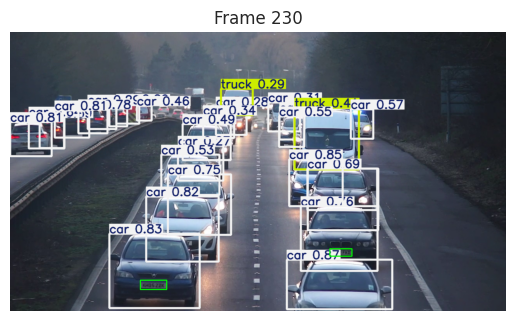


0: 384x640 22 cars, 2 trucks, 315.8ms
Speed: 7.3ms preprocess, 315.8ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 342.6ms
Speed: 4.3ms preprocess, 342.6ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 320x640 (no detections), 201.0ms
Speed: 5.0ms preprocess, 201.0ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)

0: 576x640 (no detections), 345.1ms
Speed: 5.1ms preprocess, 345.1ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 445.1ms
Speed: 4.7ms preprocess, 445.1ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 (no detections), 323.2ms
Speed: 3.6ms preprocess, 323.2ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 (no detections), 385.4ms
Speed: 3.7ms preprocess, 385.4ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 640x640 (no detections), 458.7ms
Speed: 8.0ms pre

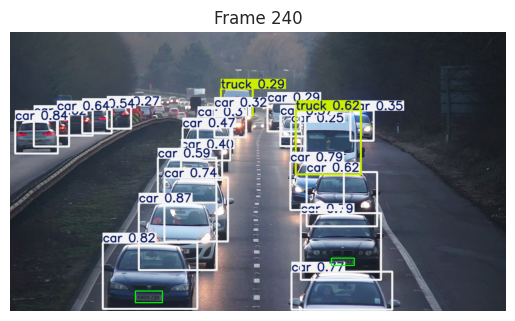


0: 384x640 21 cars, 2 trucks, 279.0ms
Speed: 4.5ms preprocess, 279.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 388.4ms
Speed: 4.9ms preprocess, 388.4ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 (no detections), 290.4ms
Speed: 5.1ms preprocess, 290.4ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 448x640 1 license_plate, 261.9ms
Speed: 3.6ms preprocess, 261.9ms inference, 6.2ms postprocess per image at shape (1, 3, 448, 640)

0: 576x640 (no detections), 402.9ms
Speed: 4.8ms preprocess, 402.9ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 (no detections), 339.5ms
Speed: 5.1ms preprocess, 339.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 1 license_plate, 311.5ms
Speed: 7.8ms preprocess, 311.5ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 256x640 (no detections), 219.6ms
Speed: 2.4ms pre

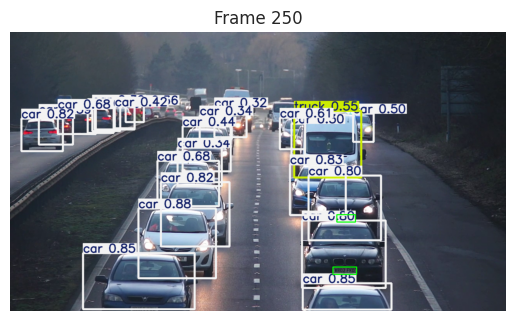


0: 384x640 24 cars, 1 truck, 260.4ms
Speed: 3.4ms preprocess, 260.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 345.3ms
Speed: 4.8ms preprocess, 345.3ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 320x640 (no detections), 208.3ms
Speed: 3.1ms preprocess, 208.3ms inference, 0.9ms postprocess per image at shape (1, 3, 320, 640)

0: 512x640 (no detections), 327.9ms
Speed: 4.0ms preprocess, 327.9ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 640x640 (no detections), 359.2ms
Speed: 5.1ms preprocess, 359.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 608x640 (no detections), 329.4ms
Speed: 5.1ms preprocess, 329.4ms inference, 1.1ms postprocess per image at shape (1, 3, 608, 640)

0: 192x640 (no detections), 128.7ms
Speed: 1.8ms preprocess, 128.7ms inference, 0.8ms postprocess per image at shape (1, 3, 192, 640)

0: 512x640 1 license_plate, 306.7ms
Speed: 4.0ms prep

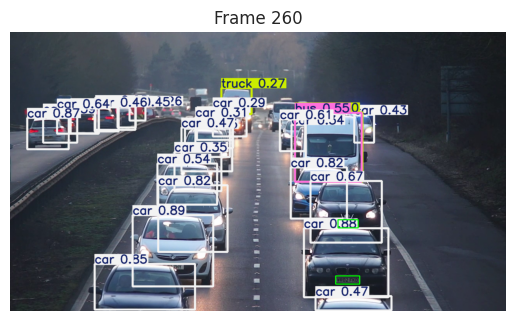


0: 384x640 24 cars, 1 bus, 2 trucks, 265.3ms
Speed: 3.4ms preprocess, 265.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 322.9ms
Speed: 5.1ms preprocess, 322.9ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 310.0ms
Speed: 4.9ms preprocess, 310.0ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)

0: 512x640 (no detections), 332.6ms
Speed: 3.7ms preprocess, 332.6ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 256x640 (no detections), 166.2ms
Speed: 3.0ms preprocess, 166.2ms inference, 0.8ms postprocess per image at shape (1, 3, 256, 640)

0: 608x640 (no detections), 350.2ms
Speed: 5.0ms preprocess, 350.2ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 347.9ms
Speed: 5.1ms preprocess, 347.9ms inference, 1.1ms postprocess per image at shape (1, 3, 608, 640)

0: 384x640 (no detections), 257.6ms
Speed: 3.

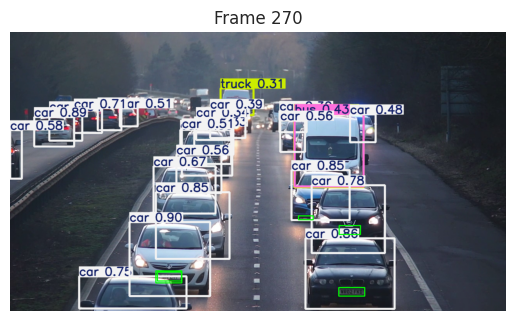


0: 384x640 22 cars, 1 bus, 2 trucks, 300.1ms
Speed: 3.7ms preprocess, 300.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 (no detections), 357.2ms
Speed: 3.6ms preprocess, 357.2ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 608x640 1 license_plate, 423.4ms
Speed: 4.9ms preprocess, 423.4ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 1 license_plate, 331.1ms
Speed: 3.8ms preprocess, 331.1ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 (no detections), 382.7ms
Speed: 6.3ms preprocess, 382.7ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 353.5ms
Speed: 4.1ms preprocess, 353.5ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 327.5ms
Speed: 4.5ms preprocess, 327.5ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 224x640 (no detections), 145.6ms
Speed: 2.

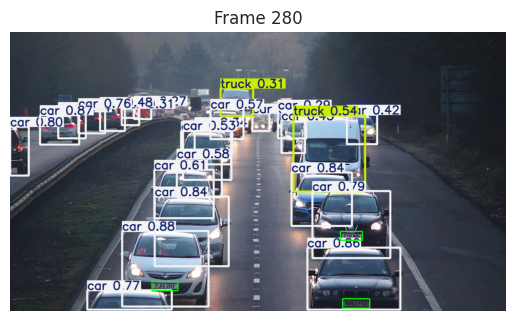


0: 384x640 23 cars, 2 trucks, 1309.9ms
Speed: 5.0ms preprocess, 1309.9ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 341.1ms
Speed: 7.0ms preprocess, 341.1ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 (no detections), 347.6ms
Speed: 5.9ms preprocess, 347.6ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 448x640 1 license_plate, 314.7ms
Speed: 5.4ms preprocess, 314.7ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)

0: 608x640 (no detections), 425.8ms
Speed: 5.5ms preprocess, 425.8ms inference, 2.3ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 387.7ms
Speed: 5.5ms preprocess, 387.7ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 315.1ms
Speed: 9.7ms preprocess, 315.1ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 337.8ms
Speed: 6.3ms p

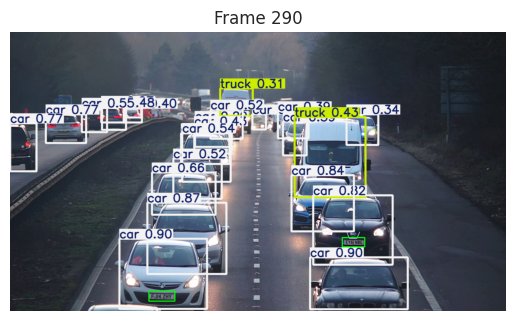


0: 384x640 22 cars, 2 trucks, 263.2ms
Speed: 3.5ms preprocess, 263.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 363.3ms
Speed: 5.6ms preprocess, 363.3ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 640)

0: 352x640 (no detections), 267.8ms
Speed: 3.4ms preprocess, 267.8ms inference, 1.3ms postprocess per image at shape (1, 3, 352, 640)

0: 544x640 (no detections), 366.8ms
Speed: 5.4ms preprocess, 366.8ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 364.0ms
Speed: 5.7ms preprocess, 364.0ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 480x640 (no detections), 276.1ms
Speed: 6.8ms preprocess, 276.1ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)

0: 576x640 1 license_plate, 336.0ms
Speed: 4.7ms preprocess, 336.0ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)

0: 640x384 (no detections), 265.1ms
Speed: 3.4ms pre

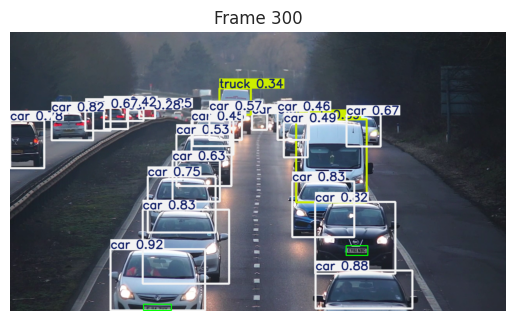


0: 384x640 21 cars, 2 trucks, 259.5ms
Speed: 3.4ms preprocess, 259.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 416x640 1 license_plate, 239.9ms
Speed: 3.7ms preprocess, 239.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)

0: 576x640 (no detections), 333.6ms
Speed: 4.1ms preprocess, 333.6ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 256x640 (no detections), 150.4ms
Speed: 2.2ms preprocess, 150.4ms inference, 1.0ms postprocess per image at shape (1, 3, 256, 640)

0: 448x640 (no detections), 235.2ms
Speed: 3.2ms preprocess, 235.2ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)

0: 576x640 1 license_plate, 346.6ms
Speed: 3.9ms preprocess, 346.6ms inference, 3.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 376.7ms
Speed: 4.2ms preprocess, 376.7ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 640x480 (no detections), 278.8ms
Speed: 6.4ms pre

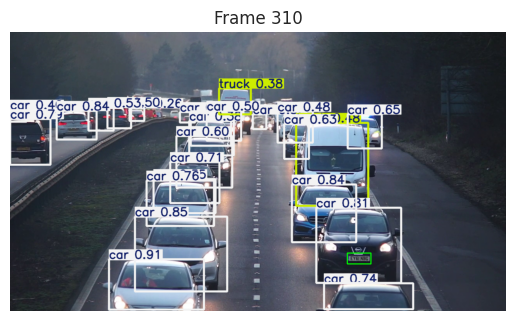


0: 384x640 20 cars, 2 trucks, 253.8ms
Speed: 3.5ms preprocess, 253.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 352x640 (no detections), 235.6ms
Speed: 3.1ms preprocess, 235.6ms inference, 0.8ms postprocess per image at shape (1, 3, 352, 640)

0: 480x640 (no detections), 260.3ms
Speed: 3.6ms preprocess, 260.3ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 576x640 1 license_plate, 307.0ms
Speed: 5.8ms preprocess, 307.0ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 280.0ms
Speed: 5.6ms preprocess, 280.0ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 323.9ms
Speed: 4.0ms preprocess, 323.9ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 640x576 (no detections), 294.3ms
Speed: 4.3ms preprocess, 294.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 576)

0: 192x640 (no detections), 115.0ms
Speed: 2.2ms pre

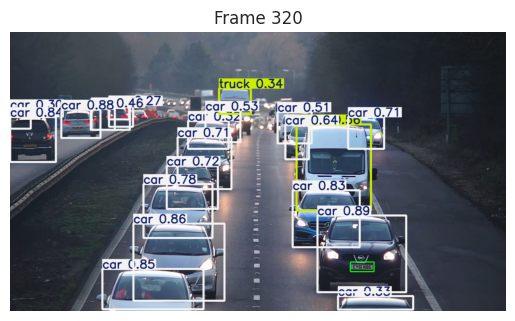


0: 384x640 20 cars, 2 trucks, 273.1ms
Speed: 5.7ms preprocess, 273.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 (no detections), 316.6ms
Speed: 3.8ms preprocess, 316.6ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 576x640 1 license_plate, 376.3ms
Speed: 4.6ms preprocess, 376.3ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 305.6ms
Speed: 4.3ms preprocess, 305.6ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 327.5ms
Speed: 5.1ms preprocess, 327.5ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 (no detections), 415.2ms
Speed: 5.2ms preprocess, 415.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 224x640 (no detections), 173.0ms
Speed: 3.3ms preprocess, 173.0ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 640)

0: 480x640 (no detections), 339.2ms
Speed: 4.8ms pre

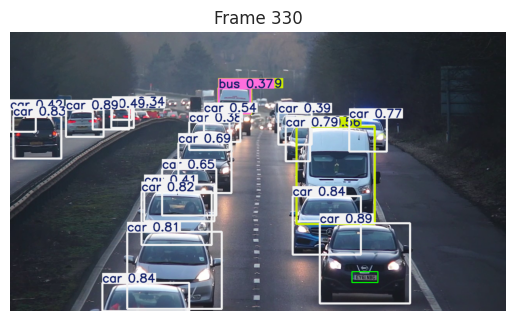


0: 384x640 21 cars, 1 bus, 2 trucks, 245.5ms
Speed: 3.5ms preprocess, 245.5ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 321.5ms
Speed: 4.9ms preprocess, 321.5ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)

0: 480x640 (no detections), 266.0ms
Speed: 5.4ms preprocess, 266.0ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 576x640 (no detections), 376.2ms
Speed: 4.7ms preprocess, 376.2ms inference, 1.8ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 315.1ms
Speed: 5.4ms preprocess, 315.1ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 336.6ms
Speed: 4.5ms preprocess, 336.6ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 (no detections), 320.7ms
Speed: 4.1ms preprocess, 320.7ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)

0: 224x640 (no detections), 144.3ms
Speed: 2.

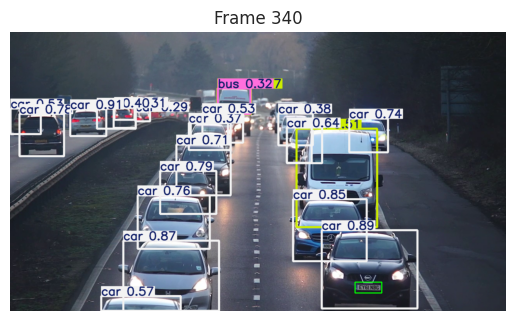


0: 384x640 22 cars, 1 bus, 2 trucks, 239.5ms
Speed: 4.1ms preprocess, 239.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 (no detections), 278.6ms
Speed: 4.1ms preprocess, 278.6ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 1 license_plate, 299.4ms
Speed: 5.0ms preprocess, 299.4ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 480x640 (no detections), 253.9ms
Speed: 5.9ms preprocess, 253.9ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 (no detections), 284.2ms
Speed: 7.0ms preprocess, 284.2ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 512x640 (no detections), 274.5ms
Speed: 3.5ms preprocess, 274.5ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 (no detections), 295.7ms
Speed: 4.0ms preprocess, 295.7ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)

0: 608x640 (no detections), 394.9ms
Speed: 5.

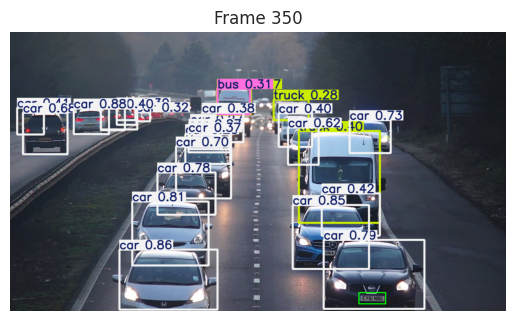


0: 384x640 22 cars, 1 bus, 3 trucks, 227.4ms
Speed: 3.0ms preprocess, 227.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 286.0ms
Speed: 3.9ms preprocess, 286.0ms inference, 1.3ms postprocess per image at shape (1, 3, 544, 640)

0: 448x640 1 license_plate, 288.5ms
Speed: 3.8ms preprocess, 288.5ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)

0: 384x640 (no detections), 288.2ms
Speed: 5.0ms preprocess, 288.2ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 (no detections), 356.9ms
Speed: 4.6ms preprocess, 356.9ms inference, 1.0ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 (no detections), 353.1ms
Speed: 4.1ms preprocess, 353.1ms inference, 0.7ms postprocess per image at shape (1, 3, 576, 640)

0: 480x640 (no detections), 277.5ms
Speed: 3.5ms preprocess, 277.5ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 (no detections), 289.2ms
Speed: 3.

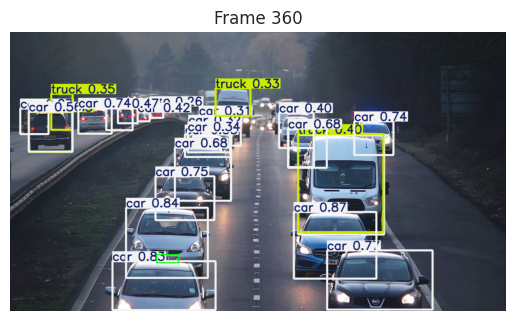


0: 384x640 22 cars, 4 trucks, 304.7ms
Speed: 3.2ms preprocess, 304.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 321.3ms
Speed: 4.0ms preprocess, 321.3ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 320x640 (no detections), 216.1ms
Speed: 6.6ms preprocess, 216.1ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)

0: 576x640 1 license_plate, 316.7ms
Speed: 4.6ms preprocess, 316.7ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)

0: 384x640 (no detections), 222.3ms
Speed: 3.4ms preprocess, 222.3ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 (no detections), 293.6ms
Speed: 4.2ms preprocess, 293.6ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 (no detections), 340.2ms
Speed: 4.4ms preprocess, 340.2ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 (no detections), 349.0ms
Speed: 4.2ms pre

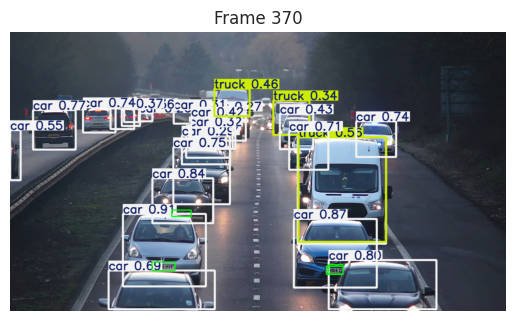


0: 384x640 22 cars, 3 trucks, 260.8ms
Speed: 9.7ms preprocess, 260.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 378.7ms
Speed: 4.4ms preprocess, 378.7ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 376.9ms
Speed: 7.4ms preprocess, 376.9ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 480x640 1 license_plate, 361.0ms
Speed: 3.8ms preprocess, 361.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)

0: 608x640 (no detections), 439.4ms
Speed: 10.0ms preprocess, 439.4ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 (no detections), 423.6ms
Speed: 8.1ms preprocess, 423.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 512x640 (no detections), 336.0ms
Speed: 4.4ms preprocess, 336.0ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 320x640 (no detections), 217.6ms
Speed: 4.3ms pr

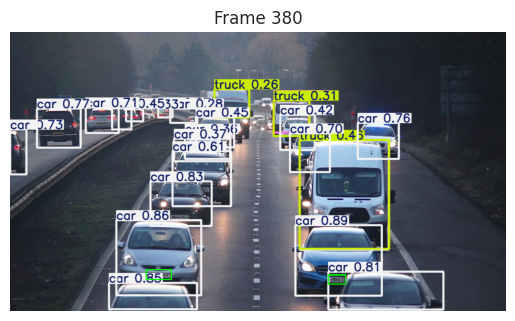


0: 384x640 18 cars, 3 trucks, 281.2ms
Speed: 3.5ms preprocess, 281.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 317.4ms
Speed: 6.7ms preprocess, 317.4ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 279.0ms
Speed: 5.9ms preprocess, 279.0ms inference, 1.2ms postprocess per image at shape (1, 3, 544, 640)

0: 480x640 1 license_plate, 250.2ms
Speed: 5.0ms preprocess, 250.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)

0: 192x640 (no detections), 109.8ms
Speed: 1.6ms preprocess, 109.8ms inference, 0.9ms postprocess per image at shape (1, 3, 192, 640)

0: 576x640 (no detections), 314.3ms
Speed: 5.2ms preprocess, 314.3ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 192x640 1 license_plate, 118.4ms
Speed: 1.7ms preprocess, 118.4ms inference, 1.1ms postprocess per image at shape (1, 3, 192, 640)

0: 576x640 (no detections), 315.2ms
Speed: 5.4ms pre

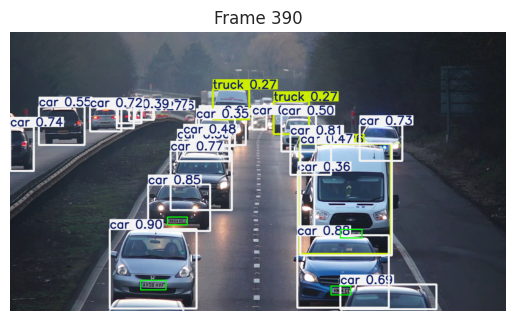


0: 384x640 23 cars, 2 trucks, 259.9ms
Speed: 4.1ms preprocess, 259.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 308.8ms
Speed: 4.4ms preprocess, 308.8ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 1 license_plate, 294.8ms
Speed: 4.0ms preprocess, 294.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 640x640 (no detections), 357.6ms
Speed: 5.1ms preprocess, 357.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 512x640 1 license_plate, 286.1ms
Speed: 3.9ms preprocess, 286.1ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 640x640 (no detections), 325.9ms
Speed: 4.2ms preprocess, 325.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x352 (no detections), 195.2ms
Speed: 2.5ms preprocess, 195.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 352)

0: 544x640 (no detections), 308.0ms
Speed: 3.5ms pre

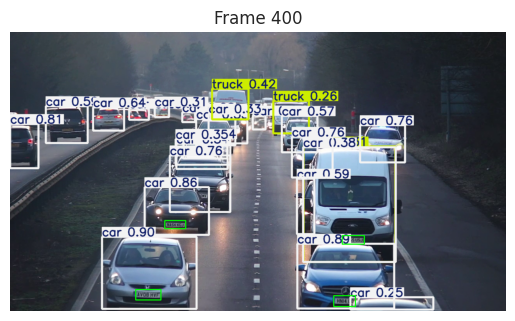


0: 384x640 20 cars, 1 truck, 273.5ms
Speed: 5.3ms preprocess, 273.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 289.7ms
Speed: 3.8ms preprocess, 289.7ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)

0: 480x640 1 license_plate, 320.9ms
Speed: 3.4ms preprocess, 320.9ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)

0: 448x640 1 license_plate, 299.5ms
Speed: 3.1ms preprocess, 299.5ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)

0: 640x448 (no detections), 319.9ms
Speed: 3.4ms preprocess, 319.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 448)

0: 608x640 (no detections), 400.9ms
Speed: 4.4ms preprocess, 400.9ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 (no detections), 393.4ms
Speed: 8.5ms preprocess, 393.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 512x640 (no detections), 327.8ms
Speed: 5.8ms prep

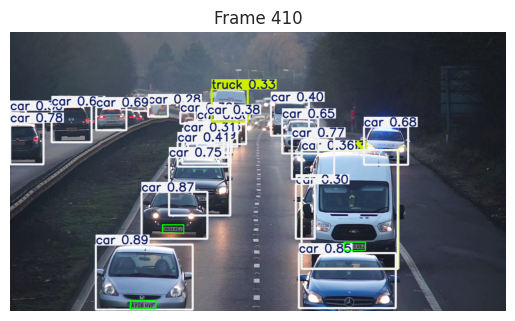


0: 384x640 22 cars, 2 trucks, 232.1ms
Speed: 2.9ms preprocess, 232.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 257.2ms
Speed: 3.6ms preprocess, 257.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)

0: 448x640 1 license_plate, 251.6ms
Speed: 3.3ms preprocess, 251.6ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)

0: 384x640 (no detections), 210.9ms
Speed: 2.8ms preprocess, 210.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 (no detections), 320.7ms
Speed: 4.3ms preprocess, 320.7ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)

0: 640x640 (no detections), 321.0ms
Speed: 8.6ms preprocess, 321.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x544 (no detections), 302.2ms
Speed: 3.7ms preprocess, 302.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 544)

0: 608x640 (no detections), 315.3ms
Speed: 4.5ms pre

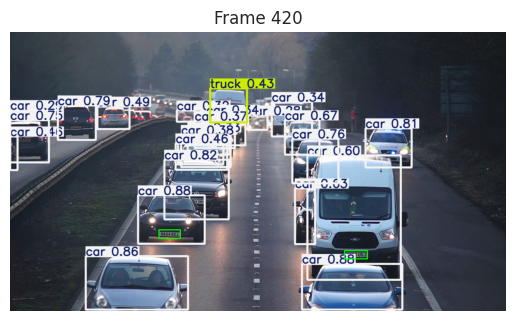


0: 384x640 24 cars, 1 truck, 322.3ms
Speed: 5.9ms preprocess, 322.3ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 346.8ms
Speed: 4.9ms preprocess, 346.8ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 288x640 (no detections), 213.1ms
Speed: 2.7ms preprocess, 213.1ms inference, 0.9ms postprocess per image at shape (1, 3, 288, 640)

0: 320x640 (no detections), 236.8ms
Speed: 2.9ms preprocess, 236.8ms inference, 3.8ms postprocess per image at shape (1, 3, 320, 640)

0: 608x640 1 license_plate, 413.0ms
Speed: 7.1ms preprocess, 413.0ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 338.7ms
Speed: 4.2ms preprocess, 338.7ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 (no detections), 370.1ms
Speed: 4.4ms preprocess, 370.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x608 (no detections), 369.9ms
Speed: 5.1ms prep

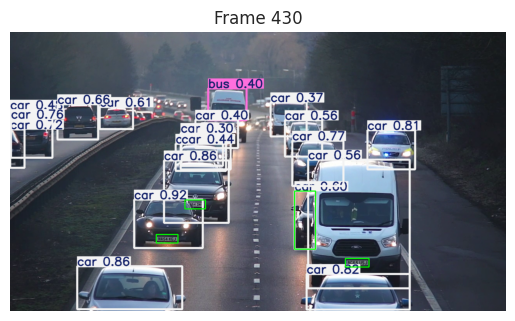


0: 384x640 20 cars, 1 bus, 252.9ms
Speed: 5.5ms preprocess, 252.9ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 274.5ms
Speed: 6.3ms preprocess, 274.5ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)

0: 288x640 (no detections), 234.4ms
Speed: 2.9ms preprocess, 234.4ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)

0: 640x640 1 license_plate, 349.8ms
Speed: 8.9ms preprocess, 349.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 (no detections), 301.3ms
Speed: 5.7ms preprocess, 301.3ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 224x640 (no detections), 135.8ms
Speed: 1.8ms preprocess, 135.8ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)

0: 576x640 (no detections), 312.0ms
Speed: 3.8ms preprocess, 312.0ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 332.5ms
Speed: 8.0ms prepro

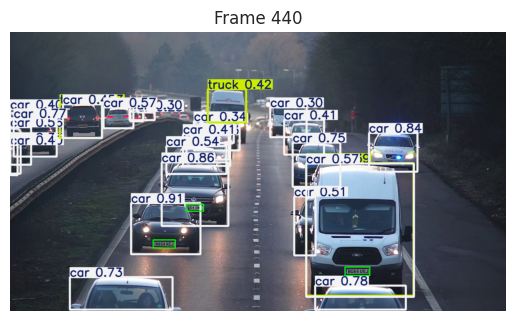


0: 384x640 25 cars, 4 trucks, 242.3ms
Speed: 3.0ms preprocess, 242.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 282.7ms
Speed: 5.3ms preprocess, 282.7ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)

0: 512x640 (no detections), 273.5ms
Speed: 3.6ms preprocess, 273.5ms inference, 0.7ms postprocess per image at shape (1, 3, 512, 640)

0: 160x640 (no detections), 117.7ms
Speed: 1.4ms preprocess, 117.7ms inference, 0.7ms postprocess per image at shape (1, 3, 160, 640)

0: 608x640 1 license_plate, 347.2ms
Speed: 4.4ms preprocess, 347.2ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 358.4ms
Speed: 4.1ms preprocess, 358.4ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 224x640 (no detections), 143.7ms
Speed: 1.9ms preprocess, 143.7ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)

0: 608x640 (no detections), 368.3ms
Speed: 4.2ms pre

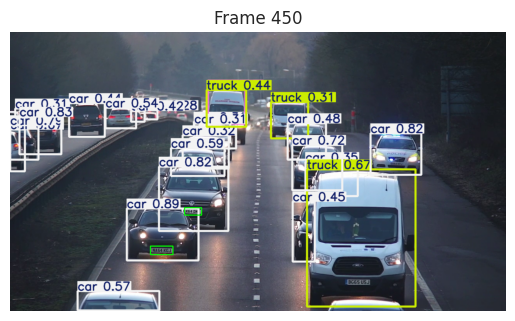


0: 384x640 22 cars, 1 bus, 3 trucks, 313.6ms
Speed: 3.4ms preprocess, 313.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 344.6ms
Speed: 8.1ms preprocess, 344.6ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)

0: 608x640 1 license_plate, 401.7ms
Speed: 5.4ms preprocess, 401.7ms inference, 3.2ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 384.4ms
Speed: 4.8ms preprocess, 384.4ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 640x544 (no detections), 337.1ms
Speed: 4.8ms preprocess, 337.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 544)

0: 544x640 (no detections), 303.6ms
Speed: 3.7ms preprocess, 303.6ms inference, 1.1ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 (no detections), 342.2ms
Speed: 6.4ms preprocess, 342.2ms inference, 1.1ms postprocess per image at shape (1, 3, 608, 640)

0: 640x256 (no detections), 155.6ms
Speed: 1.

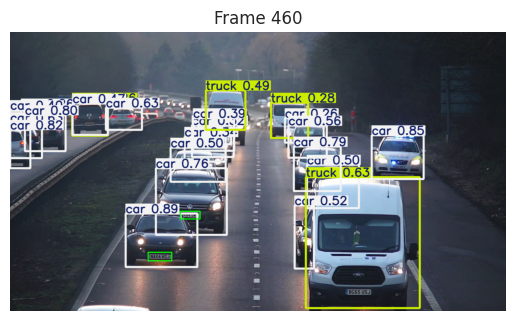


0: 384x640 20 cars, 3 trucks, 289.4ms
Speed: 3.6ms preprocess, 289.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 304.4ms
Speed: 4.1ms preprocess, 304.4ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 2 license_plates, 296.7ms
Speed: 6.6ms preprocess, 296.7ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 (no detections), 348.4ms
Speed: 5.6ms preprocess, 348.4ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 640)

0: 640x352 (no detections), 225.9ms
Speed: 3.1ms preprocess, 225.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 352)

0: 608x640 (no detections), 338.7ms
Speed: 6.1ms preprocess, 338.7ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 1 license_plate, 349.5ms
Speed: 5.2ms preprocess, 349.5ms inference, 1.6ms postprocess per image at shape (1, 3, 608, 640)

0: 448x640 (no detections), 273.7ms
Speed: 5.2ms pr

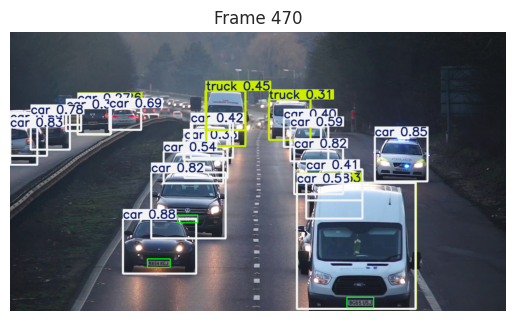


0: 384x640 20 cars, 1 bus, 5 trucks, 301.0ms
Speed: 7.3ms preprocess, 301.0ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 288.6ms
Speed: 3.7ms preprocess, 288.6ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 (no detections), 340.7ms
Speed: 6.5ms preprocess, 340.7ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 640x480 (no detections), 301.4ms
Speed: 3.8ms preprocess, 301.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)

0: 608x640 (no detections), 330.7ms
Speed: 4.3ms preprocess, 330.7ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 1 license_plate, 332.1ms
Speed: 4.8ms preprocess, 332.1ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 379.3ms
Speed: 4.6ms preprocess, 379.3ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 325.7ms
Speed: 5.

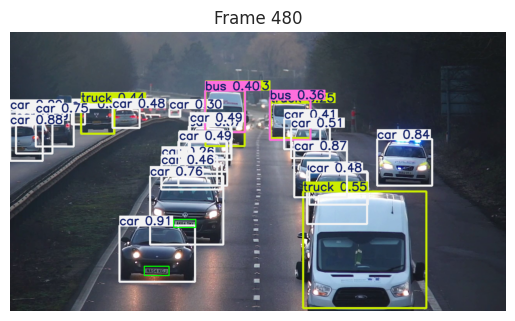


0: 384x640 23 cars, 2 buss, 4 trucks, 268.8ms
Speed: 5.7ms preprocess, 268.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 277.2ms
Speed: 7.6ms preprocess, 277.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 640x576 (no detections), 294.1ms
Speed: 6.1ms preprocess, 294.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 576)

0: 576x640 (no detections), 308.4ms
Speed: 3.8ms preprocess, 308.4ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 285.4ms
Speed: 3.8ms preprocess, 285.4ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 308.8ms
Speed: 4.4ms preprocess, 308.8ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 334.6ms
Speed: 4.8ms preprocess, 334.6ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 329.5ms
Speed: 4

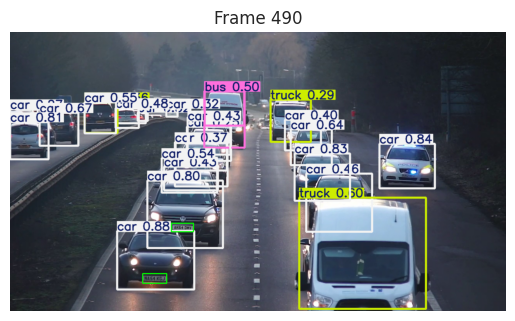


0: 384x640 21 cars, 1 bus, 3 trucks, 251.1ms
Speed: 2.8ms preprocess, 251.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 247.4ms
Speed: 5.4ms preprocess, 247.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 (no detections), 281.7ms
Speed: 5.6ms preprocess, 281.7ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 334.4ms
Speed: 6.6ms preprocess, 334.4ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 (no detections), 336.4ms
Speed: 5.7ms preprocess, 336.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 608x640 1 license_plate, 317.1ms
Speed: 4.4ms preprocess, 317.1ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 304.8ms
Speed: 6.3ms preprocess, 304.8ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 365.5ms
Speed: 5.

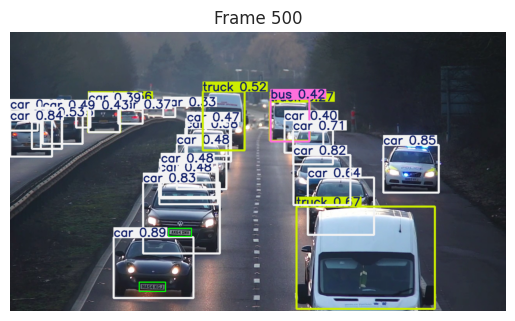


0: 384x640 23 cars, 2 buss, 4 trucks, 283.1ms
Speed: 7.6ms preprocess, 283.1ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 306.7ms
Speed: 4.4ms preprocess, 306.7ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 (no detections), 361.3ms
Speed: 3.9ms preprocess, 361.3ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 323.0ms
Speed: 4.5ms preprocess, 323.0ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 319.6ms
Speed: 4.1ms preprocess, 319.6ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 358.3ms
Speed: 5.2ms preprocess, 358.3ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 371.0ms
Speed: 8.2ms preprocess, 371.0ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 544x640 (no detections), 361.4ms
Speed: 3

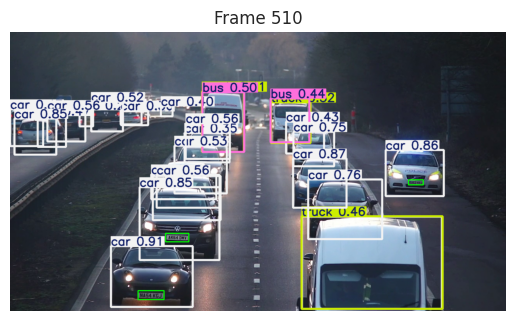


0: 384x640 24 cars, 2 buss, 3 trucks, 285.8ms
Speed: 3.6ms preprocess, 285.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 512x640 1 license_plate, 355.8ms
Speed: 4.6ms preprocess, 355.8ms inference, 5.1ms postprocess per image at shape (1, 3, 512, 640)

0: 608x640 (no detections), 436.9ms
Speed: 6.3ms preprocess, 436.9ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 341.7ms
Speed: 6.6ms preprocess, 341.7ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 358.1ms
Speed: 6.0ms preprocess, 358.1ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 1 license_plate, 339.3ms
Speed: 4.6ms preprocess, 339.3ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 (no detections), 319.4ms
Speed: 5.5ms preprocess, 319.4ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 544x640 (no detections), 331.8ms
Speed: 4

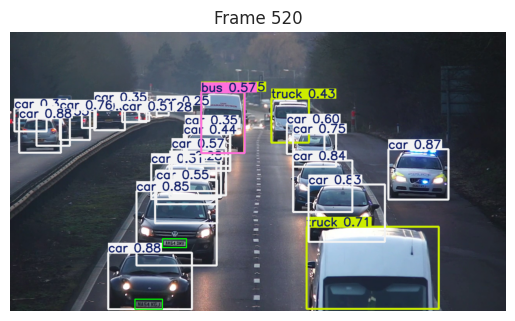


0: 384x640 23 cars, 1 bus, 3 trucks, 240.3ms
Speed: 5.6ms preprocess, 240.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 448x640 1 license_plate, 252.4ms
Speed: 3.6ms preprocess, 252.4ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)

0: 544x640 (no detections), 290.9ms
Speed: 4.3ms preprocess, 290.9ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 544x640 (no detections), 328.3ms
Speed: 4.2ms preprocess, 328.3ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 323.2ms
Speed: 4.9ms preprocess, 323.2ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 329.9ms
Speed: 5.2ms preprocess, 329.9ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 512x640 (no detections), 314.0ms
Speed: 4.0ms preprocess, 314.0ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 (no detections), 272.3ms
Speed: 4.

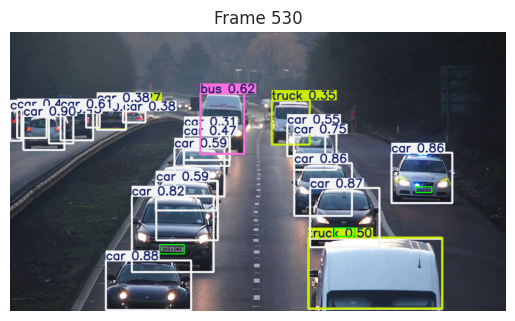


0: 384x640 23 cars, 1 bus, 4 trucks, 264.3ms
Speed: 3.0ms preprocess, 264.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 290.8ms
Speed: 4.4ms preprocess, 290.8ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 282.3ms
Speed: 4.0ms preprocess, 282.3ms inference, 1.0ms postprocess per image at shape (1, 3, 544, 640)

0: 384x640 (no detections), 214.9ms
Speed: 3.5ms preprocess, 214.9ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 285.8ms
Speed: 3.7ms preprocess, 285.8ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 307.6ms
Speed: 5.6ms preprocess, 307.6ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 355.7ms
Speed: 5.0ms preprocess, 355.7ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 300.3ms
Speed: 4.

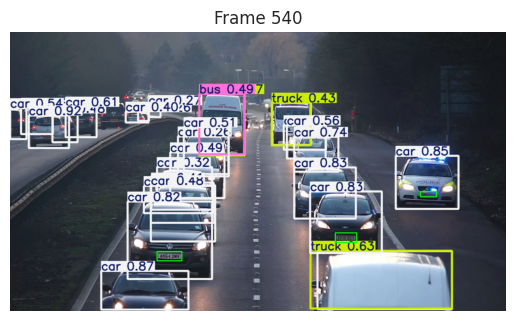


0: 384x640 25 cars, 1 bus, 3 trucks, 247.0ms
Speed: 8.2ms preprocess, 247.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 (no detections), 291.4ms
Speed: 4.0ms preprocess, 291.4ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 288x640 (no detections), 168.4ms
Speed: 2.6ms preprocess, 168.4ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)

0: 544x640 1 license_plate, 396.8ms
Speed: 4.9ms preprocess, 396.8ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 1 license_plate, 397.5ms
Speed: 4.4ms preprocess, 397.5ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 350.7ms
Speed: 4.1ms preprocess, 350.7ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 380.5ms
Speed: 5.0ms preprocess, 380.5ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 295.7ms
Speed: 5.

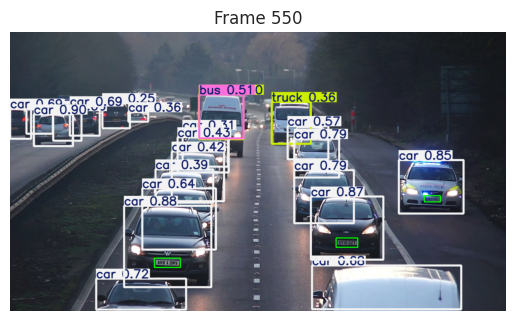


0: 384x640 21 cars, 1 bus, 2 trucks, 247.0ms
Speed: 3.3ms preprocess, 247.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 (no detections), 327.3ms
Speed: 4.2ms preprocess, 327.3ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 329.1ms
Speed: 5.0ms preprocess, 329.1ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 1 license_plate, 310.8ms
Speed: 6.8ms preprocess, 310.8ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 324.0ms
Speed: 4.1ms preprocess, 324.0ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 316.5ms
Speed: 4.4ms preprocess, 316.5ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 342.7ms
Speed: 7.8ms preprocess, 342.7ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)

0: 224x640 (no detections), 145.5ms
Speed: 2.

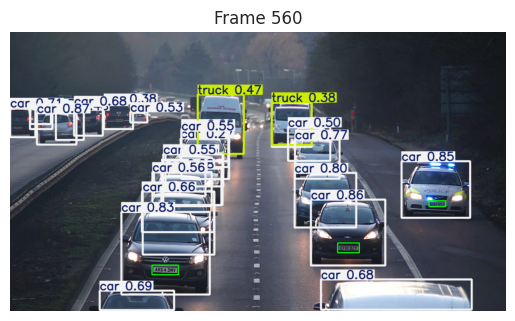


0: 384x640 24 cars, 2 trucks, 291.2ms
Speed: 3.4ms preprocess, 291.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 (no detections), 338.7ms
Speed: 3.8ms preprocess, 338.7ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 1 license_plate, 343.1ms
Speed: 4.2ms preprocess, 343.1ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 332.0ms
Speed: 6.8ms preprocess, 332.0ms inference, 1.2ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 1 license_plate, 325.4ms
Speed: 3.7ms preprocess, 325.4ms inference, 1.3ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 (no detections), 394.7ms
Speed: 5.8ms preprocess, 394.7ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 446.4ms
Speed: 3.8ms preprocess, 446.4ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 160x640 (no detections), 135.7ms
Speed: 3.0ms pre

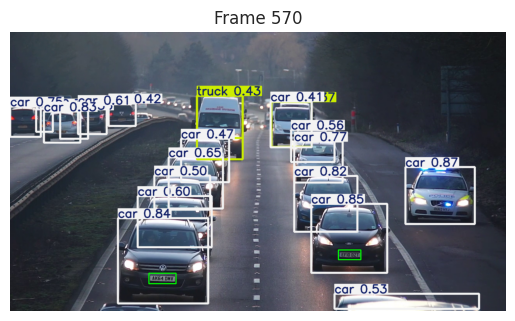


0: 384x640 18 cars, 2 trucks, 273.0ms
Speed: 5.2ms preprocess, 273.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 303.7ms
Speed: 4.3ms preprocess, 303.7ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 (no detections), 367.9ms
Speed: 8.4ms preprocess, 367.9ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 299.1ms
Speed: 4.2ms preprocess, 299.1ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 319.5ms
Speed: 6.1ms preprocess, 319.5ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 316.7ms
Speed: 4.5ms preprocess, 316.7ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 300.1ms
Speed: 5.4ms preprocess, 300.1ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 640x640 (no detections), 343.7ms
Speed: 7.1ms pre

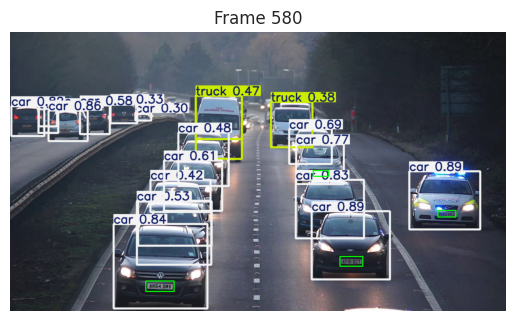


0: 384x640 18 cars, 2 trucks, 283.2ms
Speed: 5.3ms preprocess, 283.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 301.9ms
Speed: 4.5ms preprocess, 301.9ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 1 license_plate, 335.9ms
Speed: 4.5ms preprocess, 335.9ms inference, 1.4ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 296.4ms
Speed: 4.5ms preprocess, 296.4ms inference, 1.9ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 (no detections), 278.1ms
Speed: 4.0ms preprocess, 278.1ms inference, 1.1ms postprocess per image at shape (1, 3, 512, 640)

0: 608x640 (no detections), 313.1ms
Speed: 4.7ms preprocess, 313.1ms inference, 0.8ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 336.8ms
Speed: 4.1ms preprocess, 336.8ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 1 license_plate, 287.9ms
Speed: 3.8ms pre

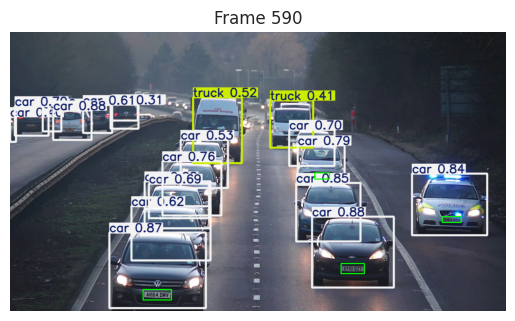


0: 384x640 17 cars, 2 trucks, 242.1ms
Speed: 3.4ms preprocess, 242.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 320.0ms
Speed: 4.5ms preprocess, 320.0ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)

0: 512x640 (no detections), 289.8ms
Speed: 4.0ms preprocess, 289.8ms inference, 0.9ms postprocess per image at shape (1, 3, 512, 640)

0: 512x640 1 license_plate, 283.1ms
Speed: 4.6ms preprocess, 283.1ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 1 license_plate, 287.0ms
Speed: 4.1ms preprocess, 287.0ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 321.9ms
Speed: 6.3ms preprocess, 321.9ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 315.1ms
Speed: 4.4ms preprocess, 315.1ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 (no detections), 319.8ms
Speed: 7.2ms pre

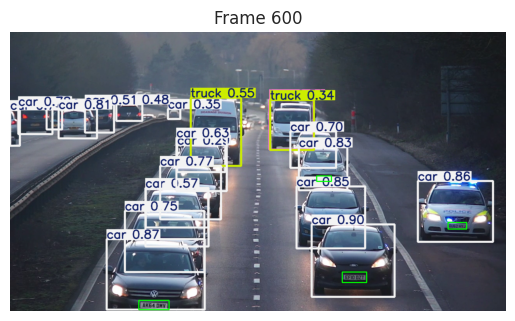


0: 384x640 20 cars, 2 buss, 2 trucks, 237.0ms
Speed: 6.5ms preprocess, 237.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 310.5ms
Speed: 4.9ms preprocess, 310.5ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 480x640 1 license_plate, 299.0ms
Speed: 4.2ms preprocess, 299.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)

0: 512x640 1 license_plate, 305.6ms
Speed: 4.3ms preprocess, 305.6ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 (no detections), 306.9ms
Speed: 4.5ms preprocess, 306.9ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 576x640 1 license_plate, 322.4ms
Speed: 4.7ms preprocess, 322.4ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)

0: 512x640 (no detections), 299.4ms
Speed: 9.2ms preprocess, 299.4ms inference, 0.8ms postprocess per image at shape (1, 3, 512, 640)

0: 544x640 (no detections), 299.8ms
Speed: 4

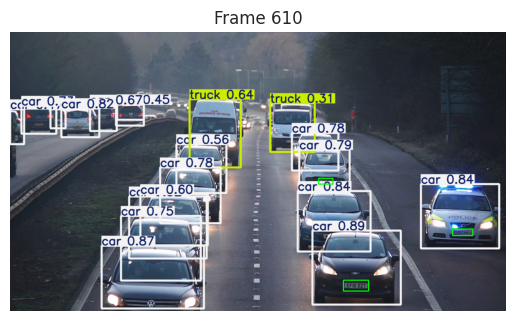


0: 384x640 17 cars, 2 trucks, 244.5ms
Speed: 7.3ms preprocess, 244.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 320.8ms
Speed: 5.4ms preprocess, 320.8ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)

0: 416x640 (no detections), 232.1ms
Speed: 3.2ms preprocess, 232.1ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)

0: 480x640 (no detections), 258.9ms
Speed: 3.2ms preprocess, 258.9ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 1 license_plate, 317.2ms
Speed: 6.6ms preprocess, 317.2ms inference, 1.3ms postprocess per image at shape (1, 3, 544, 640)

0: 544x640 (no detections), 288.3ms
Speed: 4.1ms preprocess, 288.3ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 1 license_plate, 309.3ms
Speed: 5.0ms preprocess, 309.3ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 (no detections), 300.0ms
Speed: 4.7ms pre

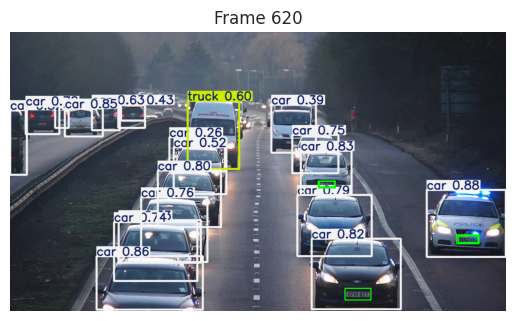


0: 384x640 18 cars, 1 truck, 249.4ms
Speed: 3.0ms preprocess, 249.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 288.4ms
Speed: 3.9ms preprocess, 288.4ms inference, 1.3ms postprocess per image at shape (1, 3, 544, 640)

0: 512x640 1 license_plate, 281.9ms
Speed: 3.9ms preprocess, 281.9ms inference, 1.3ms postprocess per image at shape (1, 3, 512, 640)

0: 480x640 (no detections), 262.7ms
Speed: 3.5ms preprocess, 262.7ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 576x640 1 license_plate, 359.8ms
Speed: 4.1ms preprocess, 359.8ms inference, 1.6ms postprocess per image at shape (1, 3, 576, 640)

0: 320x640 (no detections), 221.8ms
Speed: 2.6ms preprocess, 221.8ms inference, 0.7ms postprocess per image at shape (1, 3, 320, 640)

0: 608x640 (no detections), 372.3ms
Speed: 6.4ms preprocess, 372.3ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 372.7ms
Speed: 4.2ms prep

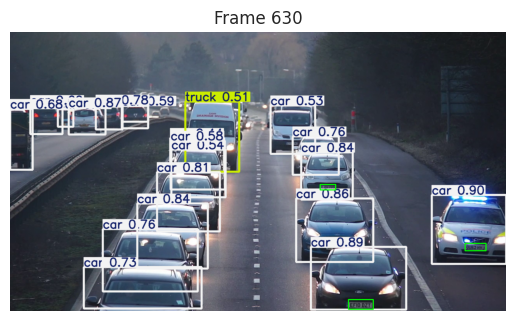


0: 384x640 19 cars, 1 truck, 250.4ms
Speed: 3.7ms preprocess, 250.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 608x640 1 license_plate, 428.9ms
Speed: 6.6ms preprocess, 428.9ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 448x640 1 license_plate, 311.6ms
Speed: 5.8ms preprocess, 311.6ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)

0: 480x640 (no detections), 387.5ms
Speed: 6.1ms preprocess, 387.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 (no detections), 324.5ms
Speed: 4.2ms preprocess, 324.5ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 359.2ms
Speed: 4.7ms preprocess, 359.2ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 354.7ms
Speed: 5.2ms preprocess, 354.7ms inference, 1.0ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 360.0ms
Speed: 4.6ms prep

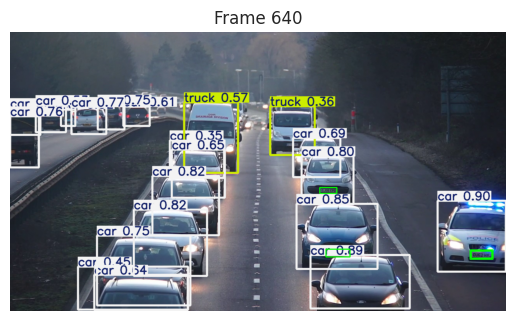


0: 384x640 19 cars, 2 trucks, 261.0ms
Speed: 6.6ms preprocess, 261.0ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)

0: 352x640 (no detections), 203.3ms
Speed: 3.1ms preprocess, 203.3ms inference, 0.8ms postprocess per image at shape (1, 3, 352, 640)

0: 640x640 1 license_plate, 416.3ms
Speed: 4.9ms preprocess, 416.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 544x640 1 license_plate, 384.7ms
Speed: 6.3ms preprocess, 384.7ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 (no detections), 334.9ms
Speed: 5.2ms preprocess, 334.9ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 342.5ms
Speed: 4.5ms preprocess, 342.5ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 325.8ms
Speed: 4.7ms preprocess, 325.8ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 306.0ms
Speed: 6.6ms pre

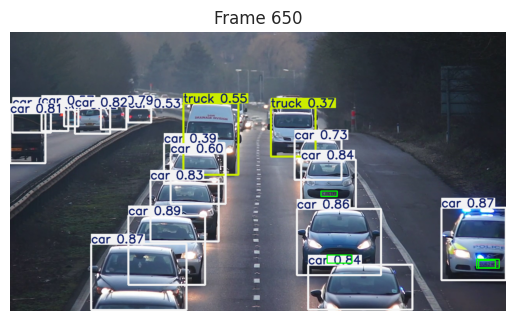


0: 384x640 16 cars, 2 trucks, 259.5ms
Speed: 3.5ms preprocess, 259.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 448x640 (no detections), 254.8ms
Speed: 3.5ms preprocess, 254.8ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)

0: 512x640 1 license_plate, 324.5ms
Speed: 5.0ms preprocess, 324.5ms inference, 2.5ms postprocess per image at shape (1, 3, 512, 640)

0: 576x640 (no detections), 392.5ms
Speed: 4.5ms preprocess, 392.5ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 640x544 (no detections), 322.5ms
Speed: 5.0ms preprocess, 322.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 544)

0: 576x640 1 license_plate, 338.3ms
Speed: 5.2ms preprocess, 338.3ms inference, 1.3ms postprocess per image at shape (1, 3, 576, 640)

0: 288x640 (no detections), 179.3ms
Speed: 2.6ms preprocess, 179.3ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)

0: 608x640 (no detections), 338.3ms
Speed: 4.6ms pre

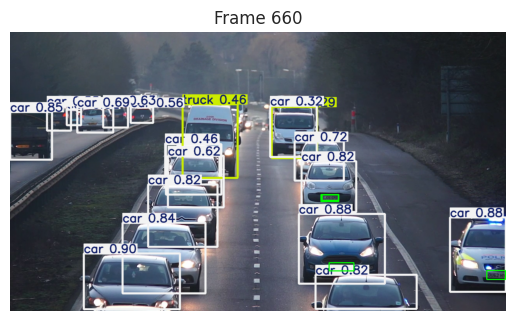


0: 384x640 19 cars, 2 trucks, 315.2ms
Speed: 5.7ms preprocess, 315.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 218.1ms
Speed: 4.7ms preprocess, 218.1ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 640x480 1 license_plate, 291.1ms
Speed: 5.8ms preprocess, 291.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)

0: 544x640 1 license_plate, 303.8ms
Speed: 11.6ms preprocess, 303.8ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 357.4ms
Speed: 8.9ms preprocess, 357.4ms inference, 1.1ms postprocess per image at shape (1, 3, 576, 640)

0: 640x576 (no detections), 372.3ms
Speed: 4.9ms preprocess, 372.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 576)

0: 224x640 (no detections), 164.2ms
Speed: 2.0ms preprocess, 164.2ms inference, 0.9ms postprocess per image at shape (1, 3, 224, 640)

0: 608x640 (no detections), 381.4ms
Speed: 5.5ms pr

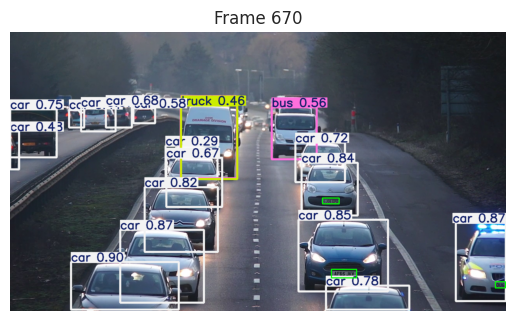


0: 384x640 17 cars, 1 bus, 1 truck, 280.1ms
Speed: 3.4ms preprocess, 280.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 288x640 (no detections), 167.2ms
Speed: 2.6ms preprocess, 167.2ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)

0: 640x416 1 license_plate, 301.3ms
Speed: 5.5ms preprocess, 301.3ms inference, 4.4ms postprocess per image at shape (1, 3, 640, 416)

0: 544x640 1 license_plate, 354.0ms
Speed: 6.3ms preprocess, 354.0ms inference, 1.6ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 437.5ms
Speed: 7.1ms preprocess, 437.5ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 368.0ms
Speed: 6.0ms preprocess, 368.0ms inference, 1.5ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 372.3ms
Speed: 4.9ms preprocess, 372.3ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 192x640 (no detections), 142.1ms
Speed: 1.9

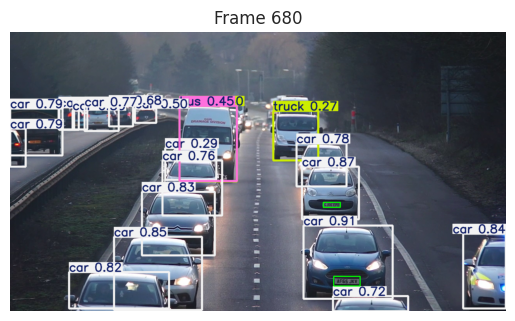


0: 384x640 17 cars, 1 bus, 2 trucks, 236.8ms
Speed: 3.4ms preprocess, 236.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 1 license_plate, 321.3ms
Speed: 7.0ms preprocess, 321.3ms inference, 1.3ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 1 license_plate, 324.9ms
Speed: 5.0ms preprocess, 324.9ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 544x640 (no detections), 284.2ms
Speed: 4.6ms preprocess, 284.2ms inference, 0.8ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 318.7ms
Speed: 4.5ms preprocess, 318.7ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 640x320 (no detections), 204.9ms
Speed: 2.7ms preprocess, 204.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 320)

0: 640x384 (no detections), 224.1ms
Speed: 3.5ms preprocess, 224.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)

0: 576x640 (no detections), 300.5ms
Speed: 4.

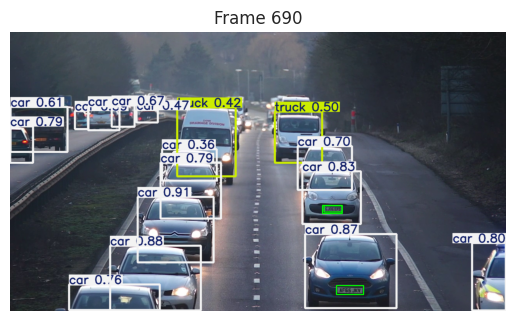


0: 384x640 15 cars, 2 trucks, 233.4ms
Speed: 8.3ms preprocess, 233.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 (no detections), 295.4ms
Speed: 4.7ms preprocess, 295.4ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)

0: 480x640 (no detections), 287.6ms
Speed: 8.0ms preprocess, 287.6ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 544x640 1 license_plate, 292.8ms
Speed: 6.4ms preprocess, 292.8ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)

0: 608x640 2 license_plates, 316.6ms
Speed: 6.7ms preprocess, 316.6ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 367.1ms
Speed: 5.1ms preprocess, 367.1ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 640x320 (no detections), 192.4ms
Speed: 4.8ms preprocess, 192.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 320)

0: 192x640 (no detections), 126.5ms
Speed: 2.0ms pr

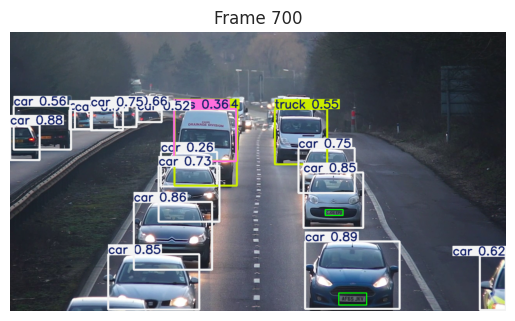


0: 384x640 16 cars, 1 bus, 2 trucks, 257.4ms
Speed: 5.6ms preprocess, 257.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 480x640 1 license_plate, 266.3ms
Speed: 5.6ms preprocess, 266.3ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)

0: 640x544 (no detections), 309.6ms
Speed: 6.7ms preprocess, 309.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 544)

0: 576x640 (no detections), 337.3ms
Speed: 5.9ms preprocess, 337.3ms inference, 1.0ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 357.6ms
Speed: 5.2ms preprocess, 357.6ms inference, 1.4ms postprocess per image at shape (1, 3, 608, 640)

0: 384x640 (no detections), 255.6ms
Speed: 3.2ms preprocess, 255.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 544x640 (no detections), 352.4ms
Speed: 4.2ms preprocess, 352.4ms inference, 0.9ms postprocess per image at shape (1, 3, 544, 640)

0: 480x640 (no detections), 306.3ms
Speed: 6.

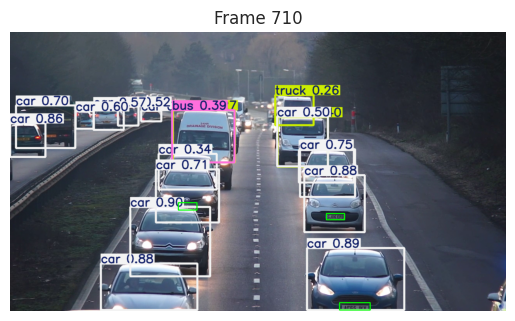


0: 384x640 17 cars, 2 buss, 1 truck, 255.5ms
Speed: 3.2ms preprocess, 255.5ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 416x640 (no detections), 278.8ms
Speed: 3.5ms preprocess, 278.8ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)

0: 320x640 (no detections), 189.6ms
Speed: 4.3ms preprocess, 189.6ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 640)

0: 576x640 (no detections), 315.4ms
Speed: 4.3ms preprocess, 315.4ms inference, 0.8ms postprocess per image at shape (1, 3, 576, 640)

0: 608x640 1 license_plate, 341.3ms
Speed: 8.0ms preprocess, 341.3ms inference, 1.3ms postprocess per image at shape (1, 3, 608, 640)

0: 608x640 (no detections), 316.4ms
Speed: 7.9ms preprocess, 316.4ms inference, 0.9ms postprocess per image at shape (1, 3, 608, 640)

0: 576x640 (no detections), 307.5ms
Speed: 4.7ms preprocess, 307.5ms inference, 1.2ms postprocess per image at shape (1, 3, 576, 640)

0: 544x640 1 license_plate, 323.2ms
Speed: 4.

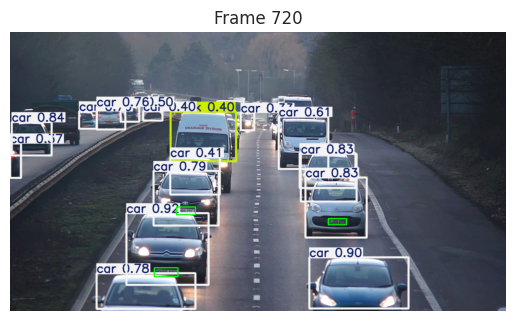


0: 384x640 16 cars, 1 truck, 272.2ms
Speed: 3.3ms preprocess, 272.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)

0: 576x640 1 license_plate, 378.6ms
Speed: 5.6ms preprocess, 378.6ms inference, 3.5ms postprocess per image at shape (1, 3, 576, 640)

0: 352x640 (no detections), 235.7ms
Speed: 2.9ms preprocess, 235.7ms inference, 4.3ms postprocess per image at shape (1, 3, 352, 640)

0: 544x640 (no detections), 341.4ms
Speed: 8.1ms preprocess, 341.4ms inference, 3.5ms postprocess per image at shape (1, 3, 544, 640)

0: 576x640 (no detections), 352.9ms
Speed: 4.4ms preprocess, 352.9ms inference, 0.9ms postprocess per image at shape (1, 3, 576, 640)

0: 640x640 2 license_plates, 377.7ms
Speed: 5.2ms preprocess, 377.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 224x640 (no detections), 182.9ms
Speed: 2.4ms preprocess, 182.9ms inference, 0.7ms postprocess per image at shape (1, 3, 224, 640)

0: 544x640 1 license_plate, 342.6ms
Speed: 4.5ms pre

In [ ]:
from ultralytics import YOLO
import cv2
import os
import matplotlib.pyplot as plt

# Load the models
car_model = YOLO("yolov8n.pt")  # Car detection model
plate_model = YOLO("/content/drive/MyDrive/Colab Notebooks/Current File/license_plate_detector.pt")  # License plate detection model

# Paths
video_path = r"/content/drive/MyDrive/Colab Notebooks/Current File/sample2.mp4"
frames_dir = r"/content/drive/MyDrive/Colab Notebooks/Current File/frames"  # Directory to save frames
plates_dir = r"/content/drive/MyDrive/Colab Notebooks/Current File/plates"  # Directory to save cropped plates

# Create directories for frames and plates if they don't exist
os.makedirs(frames_dir, exist_ok=True)
os.makedirs(plates_dir, exist_ok=True)

# Open the video file
cap = cv2.VideoCapture(video_path)
frame_count = 0
plate_tracker = set()  # Track unique license plates based on coordinates

# Process the video and save frames
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:  # Break the loop if the video ends
        print("Video processing completed.")
        break

    # Run car detection YOLO model
    car_results = car_model(frame)

    # Annotate the frame with detected cars
    annotated_frame = car_results[0].plot()

    # Loop through car detections to process license plates
    for result in car_results:
        for box in result.boxes.data.tolist():
            x1, y1, x2, y2, score, cls_id = box  # Box coordinates, score, and class ID
            cls_name = car_model.names[int(cls_id)]

            if cls_name == "car":  # Check for "car" detections
                # Crop the car region
                car_crop = frame[int(y1):int(y2), int(x1):int(x2)]

                # Run license plate detection on the cropped car region
                plate_results = plate_model(car_crop)

                for plate_result in plate_results:
                    for plate_box in plate_result.boxes.data.tolist():
                        px1, py1, px2, py2, pscore, pcls_id = plate_box  # Plate box coordinates
                        plate_crop = car_crop[int(py1):int(py2), int(px1):int(px2)]

                        # Calculate the absolute plate coordinates
                        abs_plate_coords = (int(x1) + int(px1), int(y1) + int(py1),
                                            int(x1) + int(px2), int(y1) + int(py2))

                        # Check if the plate was already detected
                        if abs_plate_coords not in plate_tracker:
                            plate_tracker.add(abs_plate_coords)  # Add to tracker

                            # Draw plate detection on the frame
                            cv2.rectangle(annotated_frame,
                                          (abs_plate_coords[0], abs_plate_coords[1]),
                                          (abs_plate_coords[2], abs_plate_coords[3]),
                                          (0, 255, 0), 2)  # Green rectangle for plates

                            # Save the cropped license plate
                            plate_path = os.path.join(plates_dir, f"frame_{frame_count:04d}_plate.jpg")
                            cv2.imwrite(plate_path, plate_crop)

    # Save the annotated frame
    frame_path = os.path.join(frames_dir, f"frame_{frame_count:04d}.jpg")
    cv2.imwrite(frame_path, annotated_frame)

    # Display the annotated frame only every 10th frame
    if frame_count % 10 == 0 or frame_count==1:
        plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
        plt.title(f"Frame {frame_count}")
        plt.axis("off")
        plt.pause(0.01)  # Pause briefly to update the plot
        plt.clf()  # Clear the plot for the next frame

    frame_count += 1

# Release video resources
cap.release()
plt.close()

print("Video processed, frames saved, and license plates cropped.")


EasyOCR Text Extraction

In [ ]:
import os
import pandas as pd
import easyocr

# Paths
plates_dir = r"/content/drive/MyDrive/Colab Notebooks/Current File/plates"  # Folder containing cropped plates
output_csv_path = r"/content/drive/MyDrive/Colab Notebooks/Current File/extracted_ocr_plates/extracted_ocr_plates.csv"  # CSV to save extracted license plates

# Initialize EasyOCR Reader
reader = easyocr.Reader(['en'])

# List to store extracted license plate information
license_plate_data = []

# Process each image in the cropped plates directory
for plate_image_name in os.listdir(plates_dir):
    plate_image_path = os.path.join(plates_dir, plate_image_name)

    if os.path.isfile(plate_image_path):
        print(f"Processing image: {plate_image_name}...")

        # Perform OCR on the image
        results = reader.readtext(plate_image_path, detail=0)

        if results:
            # Assuming the most prominent text is the license plate
            license_plate = results[0]  # Extract the first result
            print(f"Extracted Text: {license_plate}")

            # Append the extracted data
            license_plate_data.append({
                'Image_Name': plate_image_name,
                'License_Plate': license_plate
            })
        else:
            print(f"No text detected in image: {plate_image_name}")
            license_plate_data.append({
                'Image_Name': plate_image_name,
                'License_Plate': 'No Text Detected'
            })

# Save the extracted data to a CSV file
extracted_df = pd.DataFrame(license_plate_data)
extracted_df.to_csv(output_csv_path, index=False)

print(f"License plate data saved to {output_csv_path}")


Processing image: frame_0000_plate.jpg...
Extracted Text: Hksu
Processing image: frame_0001_plate.jpg...
Extracted Text: HIIsu
Processing image: frame_0002_plate.jpg...
Extracted Text: 51502J
Processing image: frame_0003_plate.jpg...
Extracted Text: 0sC J
Processing image: frame_0004_plate.jpg...
Extracted Text: 04Is OCJ
Processing image: frame_0005_plate.jpg...
Extracted Text: GusocJ
Processing image: frame_0006_plate.jpg...
Extracted Text: Gl5oG]
Processing image: frame_0007_plate.jpg...
Extracted Text: WEsU
Processing image: frame_0008_plate.jpg...
Extracted Text: Mti
Processing image: frame_0009_plate.jpg...
Extracted Text: WISIsu
Processing image: frame_0010_plate.jpg...
Extracted Text: WHsU
Processing image: frame_0011_plate.jpg...
Extracted Text: WIHsU
Processing image: frame_0012_plate.jpg...
Extracted Text: WISU
Processing image: frame_0013_plate.jpg...
Extracted Text: LEM
Processing image: frame_0014_plate.jpg...
Extracted Text: Du
Processing image: frame_0015_plate.jpg...
Ex

In [ ]:
import pandas as pd
import re

# Path to the original CSV file
original_csv_file_path = "/content/drive/MyDrive/Colab Notebooks/Current File/extracted_ocr_plates/extracted_ocr_plates.csv"

# Path to save the new normalized CSV file
normalized_csv_file_path = "/content/drive/MyDrive/Colab Notebooks/Current File/extracted_ocr_plates/normalized_extracted_ocr_plates.csv"

# Load the extracted data from the original CSV
extracted_df = pd.read_csv(original_csv_file_path)

def normalize_text(text):
    # Convert to uppercase for consistency
    normalized_text = text.upper()
    # Remove unwanted spaces
    normalized_text = re.sub(r'\s+', '', normalized_text)
    # Remove any non-alphanumeric characters
    normalized_text = re.sub(r'[^A-Z0-9]', '', normalized_text)
    return normalized_text

# Apply normalization to the 'License_Plate' column
if 'License_Plate' in extracted_df.columns:
    extracted_df['License_Plate'] = extracted_df['License_Plate'].apply(lambda x: normalize_text(x) if isinstance(x, str) else x)
else:
    print("Error: 'License_Plate' column not found in the CSV file!")

# Save the normalized data to the new CSV file
extracted_df.to_csv(normalized_csv_file_path, index=False)

print(f"Normalized text saved to: {normalized_csv_file_path}")


Normalized text saved to: /content/drive/MyDrive/Colab Notebooks/Current File/extracted_ocr_plates/normalized_extracted_ocr_plates.csv


Dataset Matching

In [ ]:
import time
import pandas as pd

# Load the normalized extracted license plates
normalized_csv_file_path = "/content/drive/MyDrive/Colab Notebooks/Current File/extracted_ocr_plates/normalized_extracted_ocr_plates.csv"
extracted_df = pd.read_csv(normalized_csv_file_path)

# Load the existing license plate database
database_path = r"/content/drive/MyDrive/Colab Notebooks/Current File/pakistan_car_license_dataset.csv"
database = pd.read_csv(database_path)

# Remove duplicate license plates from the extracted DataFrame
unique_plates_df = extracted_df.drop_duplicates(subset=['License_Plate'])

# Match only unique license plates
print("Matching each License Plate with Database...")

for _, plate_info in unique_plates_df.iterrows():
    extracted_plate = plate_info['License_Plate']

    # Match with the database
    match = database[database['License_Plate'] == extracted_plate]

    if not match.empty:
        time.sleep(1)
        print(f"\nMatched found for plate: {extracted_plate}")

        time.sleep(1)  # Pause for effect
        print("\nPlease Wait, Fetching License Details...")
        time.sleep(2)
        print("\n")

        # Display details
        owner_name = match.iloc[0]['Owner_Name']
        car_model = match.iloc[0]['Car_Model']
        registration_region = match.iloc[0]['Registration_Region']
        license_valid = match.iloc[0]['License_Valid']
        car_stolen = match.iloc[0]['Car_Stolen']
        tokens_paid = match.iloc[0]['Tokens_Paid']

        print(f"Owner Name: {owner_name}")
        print(f"Car Model: {car_model}")
        print(f"Registration Region: {registration_region}")
        print(f"License Validity: {license_valid}")
        print(f"Car Stolen: {car_stolen}")
        print(f"Tokens Paid: {tokens_paid}\n")
        print("-" * 50)

print("Matching Completed.")


Matching each License Plate with Database...

Matched found for plate: 51502J

Please Wait, Fetching License Details...


Owner Name: Fatima Zain
Car Model: Suzuki Mehran
Registration Region: Islamabad
License Validity: Valid
Car Stolen: Yes
Tokens Paid: No

--------------------------------------------------

Matched found for plate: APO5JEO

Please Wait, Fetching License Details...


Owner Name: Imran Khan
Car Model: MG HS
Registration Region: Gilgit
License Validity: Valid
Car Stolen: Yes
Tokens Paid: Yes

--------------------------------------------------

Matched found for plate: BG65USJ

Please Wait, Fetching License Details...


Owner Name: Ali Khan
Car Model: Proton Saga
Registration Region: Rawalpindi
License Validity: Valid
Car Stolen: No
Tokens Paid: Yes

--------------------------------------------------
Matching Completed.
